In [2]:
# !pip install tensorflow matplotlib scikit-learn seaborn

import os
import numpy as np
import random
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report
from scipy.stats import mode
import seaborn as sns

def set_all_seed(seed=42):
    np.random.seed(seed)
    random.seed(seed)
    import tensorflow as tf
    tf.random.set_seed(seed)


In [3]:
import kagglehub

# Download latest version dataset PlantVillage Tomato Leaf Disease
dataset_path = kagglehub.dataset_download("emmarex/plantdisease")
print("Path to dataset files:", dataset_path)

Path to dataset files: /kaggle/input/plantdisease


In [4]:
# Path dataset & setup kelas
base_dir = '/kaggle/input/plantdisease/PlantVillage' # <--- Ubah sesuai dataset Anda
all_classes = sorted([d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))])
tomato_classes = [c for c in all_classes if c.lower().startswith('tomato')]
num_classes = len(tomato_classes)
print("Kelas:", tomato_classes)

# Data Generator + Augmentasi maksimal
target_size = (64, 64)
batch_size = 16

train_gen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    brightness_range=[0.7, 1.3],
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)

train_flow = train_gen.flow_from_directory(
    base_dir,
    target_size=target_size,
    batch_size=batch_size,
    classes=tomato_classes,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

val_flow = train_gen.flow_from_directory(
    base_dir,
    target_size=target_size,
    batch_size=batch_size,
    classes=tomato_classes,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)

labels = train_flow.classes
class_weights = compute_class_weight('balanced', classes=np.unique(labels), y=labels)
class_weights = dict(enumerate(class_weights))


Kelas: ['Tomato_Bacterial_spot', 'Tomato_Early_blight', 'Tomato_Late_blight', 'Tomato_Leaf_Mold', 'Tomato_Septoria_leaf_spot', 'Tomato_Spider_mites_Two_spotted_spider_mite', 'Tomato__Target_Spot', 'Tomato__Tomato_YellowLeaf__Curl_Virus', 'Tomato__Tomato_mosaic_virus', 'Tomato_healthy']
Found 12813 images belonging to 10 classes.
Found 3198 images belonging to 10 classes.


In [5]:
def build_model(input_shape, num_classes):
    model = Sequential([
        Conv2D(16, (3,3), activation='relu', input_shape=input_shape),
        BatchNormalization(),
        Conv2D(32, (3,3), activation='relu'),
        BatchNormalization(),
        MaxPooling2D(2,2),
        Conv2D(64, (3,3), activation='relu'),
        BatchNormalization(),
        Conv2D(128, (3,3), activation='relu'),
        BatchNormalization(),
        MaxPooling2D(2,2),
        Flatten(),
        Dense(256, activation='relu'),
        Dropout(0.3),
        Dense(128, activation='relu'),
        Dropout(0.2),
        Dense(num_classes, activation='softmax')
    ])
    model.compile(optimizer=Adam(learning_rate=3e-5), loss='categorical_crossentropy', metrics=['accuracy'])
    return model


In [6]:
for i in range(3):
    print(f"\nTraining model ke-{i+1}")
    set_all_seed(42 + i*111)  # Seed berbeda untuk tiap model
    model = build_model((*target_size, 3), num_classes)
    callbacks = [
        EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        ReduceLROnPlateau(monitor='val_loss', patience=5, factor=0.2, verbose=1),
        ModelCheckpoint(f'best_model_{i}.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
    ]
    history = model.fit(
        train_flow,
        epochs=100,
        validation_data=val_flow,
        callbacks=callbacks,
        class_weight=class_weights
    )



Training model ke-1


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - accuracy: 0.3005 - loss: 2.2120
Epoch 1: val_accuracy improved from -inf to 0.57004, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 184s 218ms/step - accuracy: 0.3006 - loss: 2.2116 - val_accuracy: 0.5700 - val_loss: 1.2270 - learning_rate: 3.0000e-05
Epoch 2/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.5064 - loss: 1.4733
Epoch 2: val_accuracy improved from 0.57004 to 0.65791, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.5064 - loss: 1.4733 - val_accuracy: 0.6579 - val_loss: 0.9946 - learning_rate: 3.0000e-05
Epoch 3/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.5812 - loss: 1.2403
Epoch 3: val_accuracy improved from 0.65791 to 0.68887, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 68ms/step - accuracy: 0.5812 - loss: 1.2403 - val_accuracy: 0.6889 - val_loss: 0.8875 - learning_rate: 3.0000e-05
Epoch 4/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6246 - loss: 1.0965
Epoch 4: val_accuracy improved from 0.68887 to 0.73327, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.6246 - loss: 1.0964 - val_accuracy: 0.7333 - val_loss: 0.7699 - learning_rate: 3.0000e-05
Epoch 5/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6441 - loss: 1.0695
Epoch 5: val_accuracy improved from 0.73327 to 0.75266, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.6441 - loss: 1.0694 - val_accuracy: 0.7527 - val_loss: 0.7422 - learning_rate: 3.0000e-05
Epoch 6/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.6614 - loss: 0.9815
Epoch 6: val_accuracy improved from 0.75266 to 0.76923, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 69ms/step - accuracy: 0.6614 - loss: 0.9815 - val_accuracy: 0.7692 - val_loss: 0.6653 - learning_rate: 3.0000e-05
Epoch 7/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6944 - loss: 0.8983
Epoch 7: val_accuracy improved from 0.76923 to 0.79612, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 81s 68ms/step - accuracy: 0.6944 - loss: 0.8983 - val_accuracy: 0.7961 - val_loss: 0.6209 - learning_rate: 3.0000e-05
Epoch 8/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7063 - loss: 0.8649
Epoch 8: val_accuracy did not improve from 0.79612
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7063 - loss: 0.8649 - val_accuracy: 0.7680 - val_loss: 0.6826 - learning_rate: 3.0000e-05
Epoch 9/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7104 - loss: 0.8575
Epoch 9: val_accuracy improved from 0.79612 to 0.80675, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7104 - loss: 0.8575 - val_accuracy: 0.8068 - val_loss: 0.5708 - learning_rate: 3.0000e-05
Epoch 10/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7265 - loss: 0.8109
Epoch 10: val_accuracy improved from 0.80675 to 0.80926, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7265 - loss: 0.8109 - val_accuracy: 0.8093 - val_loss: 0.5661 - learning_rate: 3.0000e-05
Epoch 11/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7335 - loss: 0.7945
Epoch 11: val_accuracy improved from 0.80926 to 0.82708, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.7335 - loss: 0.7945 - val_accuracy: 0.8271 - val_loss: 0.5009 - learning_rate: 3.0000e-05
Epoch 12/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7435 - loss: 0.7701
Epoch 12: val_accuracy did not improve from 0.82708
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7435 - loss: 0.7701 - val_accuracy: 0.8224 - val_loss: 0.5194 - learning_rate: 3.0000e-05
Epoch 13/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.7481 - loss: 0.7448
Epoch 13: val_accuracy improved from 0.82708 to 0.82896, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 63s 79ms/step - accuracy: 0.7481 - loss: 0.7448 - val_accuracy: 0.8290 - val_loss: 0.4716 - learning_rate: 3.0000e-05
Epoch 14/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7572 - loss: 0.7006
Epoch 14: val_accuracy improved from 0.82896 to 0.84053, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 72s 67ms/step - accuracy: 0.7572 - loss: 0.7006 - val_accuracy: 0.8405 - val_loss: 0.4739 - learning_rate: 3.0000e-05
Epoch 15/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7717 - loss: 0.6873
Epoch 15: val_accuracy did not improve from 0.84053
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7717 - loss: 0.6873 - val_accuracy: 0.8371 - val_loss: 0.4650 - learning_rate: 3.0000e-05
Epoch 16/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7735 - loss: 0.6901
Epoch 16: val_accuracy did not improve from 0.84053
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7735 - loss: 0.6901 - val_accuracy: 0.8305 - val_loss: 0.4936 - learning_rate: 3.0000e-05
Epoch 17/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7753 - loss: 0.6851
Epoch 17: val_accuracy improved from 0.84053 to 0.85741, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7753 - loss: 0.6850 - val_accuracy: 0.8574 - val_loss: 0.4249 - learning_rate: 3.0000e-05
Epoch 18/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7839 - loss: 0.6443
Epoch 18: val_accuracy did not improve from 0.85741
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.7839 - loss: 0.6443 - val_accuracy: 0.8527 - val_loss: 0.4212 - learning_rate: 3.0000e-05
Epoch 19/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7950 - loss: 0.6235
Epoch 19: val_accuracy improved from 0.85741 to 0.86179, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7950 - loss: 0.6235 - val_accuracy: 0.8618 - val_loss: 0.4119 - learning_rate: 3.0000e-05
Epoch 20/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7850 - loss: 0.6247
Epoch 20: val_accuracy improved from 0.86179 to 0.87179, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7851 - loss: 0.6247 - val_accuracy: 0.8718 - val_loss: 0.3797 - learning_rate: 3.0000e-05
Epoch 21/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7993 - loss: 0.5918
Epoch 21: val_accuracy did not improve from 0.87179
801/801 ━━━━━━━━━━━━━━━━━━━━ 64s 80ms/step - accuracy: 0.7993 - loss: 0.5918 - val_accuracy: 0.8558 - val_loss: 0.4309 - learning_rate: 3.0000e-05
Epoch 22/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8163 - loss: 0.5589
Epoch 22: val_accuracy did not improve from 0.87179
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8163 - loss: 0.5590 - val_accuracy: 0.8680 - val_loss: 0.3993 - learning_rate: 3.0000e-05
Epoch 23/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8062 - loss: 0.5898
Epoch 23: val_accuracy improved from 0.87179 to 0.88462, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8062 - loss: 0.5898 - val_accuracy: 0.8846 - val_loss: 0.3390 - learning_rate: 3.0000e-05
Epoch 24/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8171 - loss: 0.5624
Epoch 24: val_accuracy improved from 0.88462 to 0.89275, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8171 - loss: 0.5624 - val_accuracy: 0.8927 - val_loss: 0.3304 - learning_rate: 3.0000e-05
Epoch 25/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8163 - loss: 0.5412
Epoch 25: val_accuracy did not improve from 0.89275
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8163 - loss: 0.5412 - val_accuracy: 0.8887 - val_loss: 0.3277 - learning_rate: 3.0000e-05
Epoch 26/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8143 - loss: 0.5473
Epoch 26: val_accuracy did not improve from 0.89275
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8143 - loss: 0.5473 - val_accuracy: 0.8915 - val_loss: 0.3211 - learning_rate: 3.0000e-05
Epoch 27/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8272 - loss: 0.5294
Epoch 27: val_accuracy did not improve from 0.89275
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8272 - loss: 0.5295 - val_accuracy: 0.8802 - val_loss: 0.3521 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 69ms/step - accuracy: 0.8284 - loss: 0.5181 - val_accuracy: 0.9003 - val_loss: 0.3264 - learning_rate: 3.0000e-05
Epoch 30/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8332 - loss: 0.4899
Epoch 30: val_accuracy did not improve from 0.90025
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8332 - loss: 0.4899 - val_accuracy: 0.8987 - val_loss: 0.3016 - learning_rate: 3.0000e-05
Epoch 31/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8424 - loss: 0.4790
Epoch 31: val_accuracy did not improve from 0.90025
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8424 - loss: 0.4790 - val_accuracy: 0.8884 - val_loss: 0.3345 - learning_rate: 3.0000e-05
Epoch 32/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8368 - loss: 0.4892
Epoch 32: val_accuracy did not improve from 0.90025
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8368 - loss: 0.4892 - val_accuracy: 0.8996 - val_loss: 0.3094 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8453 - loss: 0.4739 - val_accuracy: 0.9043 - val_loss: 0.2745 - learning_rate: 3.0000e-05
Epoch 35/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8556 - loss: 0.4416
Epoch 35: val_accuracy did not improve from 0.90432
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8556 - loss: 0.4416 - val_accuracy: 0.8799 - val_loss: 0.3521 - learning_rate: 3.0000e-05
Epoch 36/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8543 - loss: 0.4539
Epoch 36: val_accuracy did not improve from 0.90432
801/801 ━━━━━━━━━━━━━━━━━━━━ 65s 82ms/step - accuracy: 0.8543 - loss: 0.4539 - val_accuracy: 0.8952 - val_loss: 0.3268 - learning_rate: 3.0000e-05
Epoch 37/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8531 - loss: 0.4487
Epoch 37: val_accuracy did not improve from 0.90432
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8531 - loss: 0.4487 - val_accuracy: 0.8943 - val_loss: 0.3062 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8607 - loss: 0.4090 - val_accuracy: 0.9128 - val_loss: 0.2630 - learning_rate: 6.0000e-06
Epoch 41/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8716 - loss: 0.3895
Epoch 41: val_accuracy improved from 0.91276 to 0.92433, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 67ms/step - accuracy: 0.8716 - loss: 0.3894 - val_accuracy: 0.9243 - val_loss: 0.2290 - learning_rate: 6.0000e-06
Epoch 42/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8752 - loss: 0.3833
Epoch 42: val_accuracy improved from 0.92433 to 0.92464, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8752 - loss: 0.3833 - val_accuracy: 0.9246 - val_loss: 0.2321 - learning_rate: 6.0000e-06
Epoch 43/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8762 - loss: 0.3687
Epoch 43: val_accuracy did not improve from 0.92464
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8762 - loss: 0.3687 - val_accuracy: 0.9193 - val_loss: 0.2324 - learning_rate: 6.0000e-06
Epoch 44/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8715 - loss: 0.3835
Epoch 44: val_accuracy did not improve from 0.92464
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8715 - loss: 0.3835 - val_accuracy: 0.9228 - val_loss: 0.2276 - learning_rate: 6.0000e-06
Epoch 45/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8740 - loss: 0.3800
Epoch 45: val_accuracy did not improve from 0.92464
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8740 - loss: 0.3799 - val_accuracy: 0.9225 - val_loss: 0.2187 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 67ms/step - accuracy: 0.8812 - loss: 0.3528 - val_accuracy: 0.9290 - val_loss: 0.2293 - learning_rate: 6.0000e-06
Epoch 47/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8842 - loss: 0.3527
Epoch 47: val_accuracy did not improve from 0.92902
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8842 - loss: 0.3527 - val_accuracy: 0.9278 - val_loss: 0.2085 - learning_rate: 6.0000e-06
Epoch 48/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8792 - loss: 0.3535
Epoch 48: val_accuracy did not improve from 0.92902
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8792 - loss: 0.3535 - val_accuracy: 0.9240 - val_loss: 0.2137 - learning_rate: 6.0000e-06
Epoch 49/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8864 - loss: 0.3385
Epoch 49: val_accuracy did not improve from 0.92902
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8864 - loss: 0.3385 - val_accuracy: 0.9246 - val_loss: 0.2231 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8792 - loss: 0.3556 - val_accuracy: 0.9350 - val_loss: 0.2016 - learning_rate: 6.0000e-06
Epoch 51/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8881 - loss: 0.3367
Epoch 51: val_accuracy did not improve from 0.93496
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8880 - loss: 0.3367 - val_accuracy: 0.9259 - val_loss: 0.2185 - learning_rate: 6.0000e-06
Epoch 52/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8814 - loss: 0.3508
Epoch 52: val_accuracy did not improve from 0.93496
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8814 - loss: 0.3508 - val_accuracy: 0.9293 - val_loss: 0.2109 - learning_rate: 6.0000e-06
Epoch 53/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8922 - loss: 0.3367
Epoch 53: val_accuracy did not improve from 0.93496
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8921 - loss: 0.3367 - val_accuracy: 0.9287 - val_loss: 0.2271 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.8938 - loss: 0.3185 - val_accuracy: 0.9353 - val_loss: 0.2020 - learning_rate: 2.4000e-07
Epoch 63/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - accuracy: 0.8926 - loss: 0.3129
Epoch 63: val_accuracy improved from 0.93527 to 0.93558, saving model to best_model_0.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 63ms/step - accuracy: 0.8926 - loss: 0.3129 - val_accuracy: 0.9356 - val_loss: 0.2067 - learning_rate: 2.4000e-07
Epoch 64/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.8903 - loss: 0.3172
Epoch 64: val_accuracy did not improve from 0.93558
801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.8903 - loss: 0.3172 - val_accuracy: 0.9296 - val_loss: 0.2040 - learning_rate: 2.4000e-07
Epoch 65/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8883 - loss: 0.3314
Epoch 65: val_accuracy did not improve from 0.93558
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8883 - loss: 0.3314 - val_accuracy: 0.9340 - val_loss: 0.2000 - learning_rate: 2.4000e-07
Epoch 66/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.8939 - loss: 0.3209
Epoch 66: ReduceLROnPlateau reducing learning rate to 4.799999828719592e-08.

Epoch 66: val_accuracy did not improve from 0.93558
801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.8

801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 64ms/step - accuracy: 0.8957 - loss: 0.3210 - val_accuracy: 0.9359 - val_loss: 0.2024 - learning_rate: 4.8000e-08
Epoch 68/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.8895 - loss: 0.3305
Epoch 68: val_accuracy did not improve from 0.93590
801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.8895 - loss: 0.3305 - val_accuracy: 0.9353 - val_loss: 0.1968 - learning_rate: 4.8000e-08
Epoch 69/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8857 - loss: 0.3255
Epoch 69: val_accuracy did not improve from 0.93590
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8857 - loss: 0.3255 - val_accuracy: 0.9343 - val_loss: 0.2057 - learning_rate: 4.8000e-08
Epoch 70/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8910 - loss: 0.3250
Epoch 70: val_accuracy did not improve from 0.93590
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8910 - loss: 0.3250 - val_accuracy: 0.9331 - val_loss: 0.2136 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8929 - loss: 0.3283 - val_accuracy: 0.9412 - val_loss: 0.1926 - learning_rate: 9.6000e-09
Epoch 73/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8917 - loss: 0.3232
Epoch 73: val_accuracy did not improve from 0.94121
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8917 - loss: 0.3232 - val_accuracy: 0.9331 - val_loss: 0.2076 - learning_rate: 9.6000e-09
Epoch 74/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8923 - loss: 0.3178
Epoch 74: val_accuracy did not improve from 0.94121
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8923 - loss: 0.3178 - val_accuracy: 0.9293 - val_loss: 0.2168 - learning_rate: 9.6000e-09
Epoch 75/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8972 - loss: 0.3135
Epoch 75: val_accuracy did not improve from 0.94121
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8972 - loss: 0.3135 - val_accuracy: 0.9381 - val_loss: 0.1868 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 64s 71ms/step - accuracy: 0.3063 - loss: 2.2093 - val_accuracy: 0.5963 - val_loss: 1.1792 - learning_rate: 3.0000e-05
Epoch 2/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.5306 - loss: 1.4167
Epoch 2: val_accuracy improved from 0.59631 to 0.68011, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 64ms/step - accuracy: 0.5306 - loss: 1.4166 - val_accuracy: 0.6801 - val_loss: 0.9647 - learning_rate: 3.0000e-05
Epoch 3/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.5949 - loss: 1.2034
Epoch 3: val_accuracy improved from 0.68011 to 0.71169, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.5949 - loss: 1.2033 - val_accuracy: 0.7117 - val_loss: 0.8524 - learning_rate: 3.0000e-05
Epoch 4/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.6285 - loss: 1.1116
Epoch 4: val_accuracy improved from 0.71169 to 0.74046, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 51s 64ms/step - accuracy: 0.6285 - loss: 1.1115 - val_accuracy: 0.7405 - val_loss: 0.7721 - learning_rate: 3.0000e-05
Epoch 5/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.6479 - loss: 1.0290
Epoch 5: val_accuracy improved from 0.74046 to 0.77111, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.6479 - loss: 1.0289 - val_accuracy: 0.7711 - val_loss: 0.7008 - learning_rate: 3.0000e-05
Epoch 6/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.6740 - loss: 0.9472
Epoch 6: val_accuracy improved from 0.77111 to 0.79862, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.6740 - loss: 0.9472 - val_accuracy: 0.7986 - val_loss: 0.6126 - learning_rate: 3.0000e-05
Epoch 7/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6953 - loss: 0.8986
Epoch 7: val_accuracy did not improve from 0.79862
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.6953 - loss: 0.8986 - val_accuracy: 0.7811 - val_loss: 0.6533 - learning_rate: 3.0000e-05
Epoch 8/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7101 - loss: 0.8575
Epoch 8: val_accuracy improved from 0.79862 to 0.79894, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 81s 67ms/step - accuracy: 0.7101 - loss: 0.8575 - val_accuracy: 0.7989 - val_loss: 0.5694 - learning_rate: 3.0000e-05
Epoch 9/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7178 - loss: 0.8268
Epoch 9: val_accuracy improved from 0.79894 to 0.81739, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7178 - loss: 0.8268 - val_accuracy: 0.8174 - val_loss: 0.5268 - learning_rate: 3.0000e-05
Epoch 10/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.7372 - loss: 0.7870
Epoch 10: val_accuracy improved from 0.81739 to 0.81895, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.7372 - loss: 0.7870 - val_accuracy: 0.8189 - val_loss: 0.5266 - learning_rate: 3.0000e-05
Epoch 11/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7403 - loss: 0.7619
Epoch 11: val_accuracy improved from 0.81895 to 0.82770, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.7403 - loss: 0.7619 - val_accuracy: 0.8277 - val_loss: 0.4968 - learning_rate: 3.0000e-05
Epoch 12/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7466 - loss: 0.7547
Epoch 12: val_accuracy improved from 0.82770 to 0.84459, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 69ms/step - accuracy: 0.7466 - loss: 0.7547 - val_accuracy: 0.8446 - val_loss: 0.4689 - learning_rate: 3.0000e-05
Epoch 13/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7676 - loss: 0.6751
Epoch 13: val_accuracy did not improve from 0.84459
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7676 - loss: 0.6752 - val_accuracy: 0.8361 - val_loss: 0.4653 - learning_rate: 3.0000e-05
Epoch 14/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7690 - loss: 0.6649
Epoch 14: val_accuracy improved from 0.84459 to 0.85210, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7690 - loss: 0.6649 - val_accuracy: 0.8521 - val_loss: 0.4411 - learning_rate: 3.0000e-05
Epoch 15/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7714 - loss: 0.6829
Epoch 15: val_accuracy did not improve from 0.85210
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.7713 - loss: 0.6829 - val_accuracy: 0.8512 - val_loss: 0.4304 - learning_rate: 3.0000e-05
Epoch 16/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7724 - loss: 0.6693
Epoch 16: val_accuracy did not improve from 0.85210
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.7724 - loss: 0.6692 - val_accuracy: 0.8521 - val_loss: 0.4290 - learning_rate: 3.0000e-05
Epoch 17/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7829 - loss: 0.6446
Epoch 17: val_accuracy did not improve from 0.85210
801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 68ms/step - accuracy: 0.7829 - loss: 0.6446 - val_accuracy: 0.8477 - val_loss: 0.4450 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 68ms/step - accuracy: 0.7882 - loss: 0.6286 - val_accuracy: 0.8646 - val_loss: 0.3832 - learning_rate: 3.0000e-05
Epoch 19/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7936 - loss: 0.6106
Epoch 19: val_accuracy did not improve from 0.86460
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7936 - loss: 0.6106 - val_accuracy: 0.8634 - val_loss: 0.4153 - learning_rate: 3.0000e-05
Epoch 20/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8091 - loss: 0.5853
Epoch 20: val_accuracy did not improve from 0.86460
801/801 ━━━━━━━━━━━━━━━━━━━━ 92s 81ms/step - accuracy: 0.8091 - loss: 0.5853 - val_accuracy: 0.8602 - val_loss: 0.4300 - learning_rate: 3.0000e-05
Epoch 21/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7989 - loss: 0.5942
Epoch 21: val_accuracy improved from 0.86460 to 0.87711, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.7989 - loss: 0.5942 - val_accuracy: 0.8771 - val_loss: 0.3658 - learning_rate: 3.0000e-05
Epoch 22/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8150 - loss: 0.5638
Epoch 22: val_accuracy did not improve from 0.87711
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8150 - loss: 0.5638 - val_accuracy: 0.8671 - val_loss: 0.3811 - learning_rate: 3.0000e-05
Epoch 23/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8130 - loss: 0.5561
Epoch 23: val_accuracy did not improve from 0.87711
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8130 - loss: 0.5561 - val_accuracy: 0.8652 - val_loss: 0.3823 - learning_rate: 3.0000e-05
Epoch 24/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8154 - loss: 0.5503
Epoch 24: val_accuracy did not improve from 0.87711
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8154 - loss: 0.5503 - val_accuracy: 0.8718 - val_loss: 0.3804 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 83s 68ms/step - accuracy: 0.8221 - loss: 0.5355 - val_accuracy: 0.8896 - val_loss: 0.3295 - learning_rate: 3.0000e-05
Epoch 26/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8200 - loss: 0.5172
Epoch 26: val_accuracy did not improve from 0.88962
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8200 - loss: 0.5171 - val_accuracy: 0.8859 - val_loss: 0.3283 - learning_rate: 3.0000e-05
Epoch 27/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8275 - loss: 0.4920
Epoch 27: val_accuracy did not improve from 0.88962
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8275 - loss: 0.4920 - val_accuracy: 0.8846 - val_loss: 0.3292 - learning_rate: 3.0000e-05
Epoch 28/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8339 - loss: 0.5108
Epoch 28: val_accuracy improved from 0.88962 to 0.89462, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8339 - loss: 0.5108 - val_accuracy: 0.8946 - val_loss: 0.3065 - learning_rate: 3.0000e-05
Epoch 29/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8319 - loss: 0.4998
Epoch 29: val_accuracy did not improve from 0.89462
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8319 - loss: 0.4998 - val_accuracy: 0.8802 - val_loss: 0.3299 - learning_rate: 3.0000e-05
Epoch 30/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8470 - loss: 0.4620
Epoch 30: val_accuracy improved from 0.89462 to 0.89806, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8470 - loss: 0.4620 - val_accuracy: 0.8981 - val_loss: 0.3005 - learning_rate: 3.0000e-05
Epoch 31/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8357 - loss: 0.4853
Epoch 31: val_accuracy did not improve from 0.89806
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 71ms/step - accuracy: 0.8357 - loss: 0.4853 - val_accuracy: 0.8874 - val_loss: 0.3242 - learning_rate: 3.0000e-05
Epoch 32/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8389 - loss: 0.4663
Epoch 32: val_accuracy improved from 0.89806 to 0.90338, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 90s 80ms/step - accuracy: 0.8389 - loss: 0.4663 - val_accuracy: 0.9034 - val_loss: 0.2860 - learning_rate: 3.0000e-05
Epoch 33/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8413 - loss: 0.4499
Epoch 33: val_accuracy did not improve from 0.90338
801/801 ━━━━━━━━━━━━━━━━━━━━ 65s 81ms/step - accuracy: 0.8413 - loss: 0.4499 - val_accuracy: 0.9028 - val_loss: 0.2780 - learning_rate: 3.0000e-05
Epoch 34/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8502 - loss: 0.4407
Epoch 34: val_accuracy improved from 0.90338 to 0.91057, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8502 - loss: 0.4407 - val_accuracy: 0.9106 - val_loss: 0.2565 - learning_rate: 3.0000e-05
Epoch 35/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8610 - loss: 0.4115
Epoch 35: val_accuracy did not improve from 0.91057
801/801 ━━━━━━━━━━━━━━━━━━━━ 65s 81ms/step - accuracy: 0.8610 - loss: 0.4115 - val_accuracy: 0.9053 - val_loss: 0.2711 - learning_rate: 3.0000e-05
Epoch 36/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8654 - loss: 0.4137
Epoch 36: val_accuracy did not improve from 0.91057
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 69ms/step - accuracy: 0.8654 - loss: 0.4137 - val_accuracy: 0.8877 - val_loss: 0.3397 - learning_rate: 3.0000e-05
Epoch 37/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8597 - loss: 0.4222
Epoch 37: val_accuracy did not improve from 0.91057
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8597 - loss: 0.4222 - val_accuracy: 0.9093 - val_loss: 0.2817 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 79s 68ms/step - accuracy: 0.8748 - loss: 0.3738 - val_accuracy: 0.9250 - val_loss: 0.2234 - learning_rate: 6.0000e-06
Epoch 41/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8819 - loss: 0.3541
Epoch 41: val_accuracy did not improve from 0.92495
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8819 - loss: 0.3542 - val_accuracy: 0.9231 - val_loss: 0.2305 - learning_rate: 6.0000e-06
Epoch 42/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8803 - loss: 0.3573
Epoch 42: val_accuracy improved from 0.92495 to 0.92683, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8803 - loss: 0.3573 - val_accuracy: 0.9268 - val_loss: 0.2239 - learning_rate: 6.0000e-06
Epoch 43/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8795 - loss: 0.3578
Epoch 43: val_accuracy did not improve from 0.92683
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8795 - loss: 0.3578 - val_accuracy: 0.9206 - val_loss: 0.2226 - learning_rate: 6.0000e-06
Epoch 44/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8790 - loss: 0.3558
Epoch 44: val_accuracy improved from 0.92683 to 0.93183, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8790 - loss: 0.3558 - val_accuracy: 0.9318 - val_loss: 0.2029 - learning_rate: 6.0000e-06
Epoch 45/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8836 - loss: 0.3426
Epoch 45: val_accuracy did not improve from 0.93183
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8836 - loss: 0.3426 - val_accuracy: 0.9237 - val_loss: 0.2170 - learning_rate: 6.0000e-06
Epoch 46/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8827 - loss: 0.3625
Epoch 46: val_accuracy improved from 0.93183 to 0.93215, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 69ms/step - accuracy: 0.8827 - loss: 0.3625 - val_accuracy: 0.9321 - val_loss: 0.2181 - learning_rate: 6.0000e-06
Epoch 47/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8844 - loss: 0.3440
Epoch 47: val_accuracy improved from 0.93215 to 0.93308, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 81s 67ms/step - accuracy: 0.8844 - loss: 0.3440 - val_accuracy: 0.9331 - val_loss: 0.2034 - learning_rate: 6.0000e-06
Epoch 48/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8866 - loss: 0.3463
Epoch 48: val_accuracy did not improve from 0.93308
801/801 ━━━━━━━━━━━━━━━━━━━━ 64s 80ms/step - accuracy: 0.8866 - loss: 0.3463 - val_accuracy: 0.9265 - val_loss: 0.2175 - learning_rate: 6.0000e-06
Epoch 49/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8855 - loss: 0.3427
Epoch 49: val_accuracy improved from 0.93308 to 0.93934, saving model to best_model_1.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8855 - loss: 0.3427 - val_accuracy: 0.9393 - val_loss: 0.1872 - learning_rate: 6.0000e-06
Epoch 50/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8882 - loss: 0.3395
Epoch 50: val_accuracy did not improve from 0.93934
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8882 - loss: 0.3395 - val_accuracy: 0.9334 - val_loss: 0.1962 - learning_rate: 6.0000e-06
Epoch 51/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8881 - loss: 0.3282
Epoch 51: val_accuracy did not improve from 0.93934
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8881 - loss: 0.3282 - val_accuracy: 0.9296 - val_loss: 0.2139 - learning_rate: 6.0000e-06
Epoch 52/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8857 - loss: 0.3370
Epoch 52: val_accuracy did not improve from 0.93934
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8857 - loss: 0.3370 - val_accuracy: 0.9318 - val_loss: 0.2043 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8958 - loss: 0.3194 - val_accuracy: 0.9400 - val_loss: 0.1792 - learning_rate: 2.4000e-07
Epoch 63/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8903 - loss: 0.3174
Epoch 63: val_accuracy did not improve from 0.93996
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8904 - loss: 0.3174 - val_accuracy: 0.9343 - val_loss: 0.1962 - learning_rate: 2.4000e-07
Epoch 64/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8993 - loss: 0.3103
Epoch 64: val_accuracy did not improve from 0.93996
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8993 - loss: 0.3103 - val_accuracy: 0.9315 - val_loss: 0.2093 - learning_rate: 2.4000e-07
Epoch 65/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8990 - loss: 0.2927
Epoch 65: val_accuracy did not improve from 0.93996
801/801 ━━━━━━━━━━━━━━━━━━━━ 67s 84ms/step - accuracy: 0.8990 - loss: 0.2927 - val_accuracy: 0.9362 - val_loss: 0.1874 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 66s 74ms/step - accuracy: 0.2519 - loss: 2.2977 - val_accuracy: 0.5607 - val_loss: 1.2805 - learning_rate: 3.0000e-05
Epoch 2/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.4875 - loss: 1.5413
Epoch 2: val_accuracy improved from 0.56066 to 0.67230, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.4875 - loss: 1.5412 - val_accuracy: 0.6723 - val_loss: 0.9742 - learning_rate: 3.0000e-05
Epoch 3/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.5670 - loss: 1.2814
Epoch 3: val_accuracy improved from 0.67230 to 0.70544, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.5670 - loss: 1.2814 - val_accuracy: 0.7054 - val_loss: 0.8602 - learning_rate: 3.0000e-05
Epoch 4/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6128 - loss: 1.1339
Epoch 4: val_accuracy improved from 0.70544 to 0.74422, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 69ms/step - accuracy: 0.6128 - loss: 1.1339 - val_accuracy: 0.7442 - val_loss: 0.7433 - learning_rate: 3.0000e-05
Epoch 5/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6464 - loss: 1.0689
Epoch 5: val_accuracy did not improve from 0.74422
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.6464 - loss: 1.0689 - val_accuracy: 0.7336 - val_loss: 0.7442 - learning_rate: 3.0000e-05
Epoch 6/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.6646 - loss: 0.9757
Epoch 6: val_accuracy improved from 0.74422 to 0.76235, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.6646 - loss: 0.9757 - val_accuracy: 0.7624 - val_loss: 0.6860 - learning_rate: 3.0000e-05
Epoch 7/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6755 - loss: 0.9375
Epoch 7: val_accuracy improved from 0.76235 to 0.77517, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 81s 67ms/step - accuracy: 0.6755 - loss: 0.9374 - val_accuracy: 0.7752 - val_loss: 0.6631 - learning_rate: 3.0000e-05
Epoch 8/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6942 - loss: 0.8949
Epoch 8: val_accuracy improved from 0.77517 to 0.78518, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.6942 - loss: 0.8949 - val_accuracy: 0.7852 - val_loss: 0.6119 - learning_rate: 3.0000e-05
Epoch 9/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7084 - loss: 0.8497
Epoch 9: val_accuracy improved from 0.78518 to 0.80269, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.7084 - loss: 0.8497 - val_accuracy: 0.8027 - val_loss: 0.5785 - learning_rate: 3.0000e-05
Epoch 10/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7264 - loss: 0.8056
Epoch 10: val_accuracy improved from 0.80269 to 0.80738, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7264 - loss: 0.8056 - val_accuracy: 0.8074 - val_loss: 0.5585 - learning_rate: 3.0000e-05
Epoch 11/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7268 - loss: 0.7898
Epoch 11: val_accuracy improved from 0.80738 to 0.81520, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.7268 - loss: 0.7898 - val_accuracy: 0.8152 - val_loss: 0.5193 - learning_rate: 3.0000e-05
Epoch 12/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7349 - loss: 0.7845
Epoch 12: val_accuracy did not improve from 0.81520
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7349 - loss: 0.7845 - val_accuracy: 0.8136 - val_loss: 0.5282 - learning_rate: 3.0000e-05
Epoch 13/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7467 - loss: 0.7778
Epoch 13: val_accuracy improved from 0.81520 to 0.81582, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.7467 - loss: 0.7778 - val_accuracy: 0.8158 - val_loss: 0.5223 - learning_rate: 3.0000e-05
Epoch 14/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.7512 - loss: 0.7436
Epoch 14: val_accuracy improved from 0.81582 to 0.84834, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.7512 - loss: 0.7436 - val_accuracy: 0.8483 - val_loss: 0.4536 - learning_rate: 3.0000e-05
Epoch 15/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7632 - loss: 0.6849
Epoch 15: val_accuracy did not improve from 0.84834
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.7632 - loss: 0.6849 - val_accuracy: 0.8358 - val_loss: 0.4729 - learning_rate: 3.0000e-05
Epoch 16/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7662 - loss: 0.6909
Epoch 16: val_accuracy did not improve from 0.84834
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7662 - loss: 0.6909 - val_accuracy: 0.8352 - val_loss: 0.4798 - learning_rate: 3.0000e-05
Epoch 17/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.7701 - loss: 0.6839
Epoch 17: val_accuracy improved from 0.84834 to 0.85178, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 81s 67ms/step - accuracy: 0.7701 - loss: 0.6839 - val_accuracy: 0.8518 - val_loss: 0.4410 - learning_rate: 3.0000e-05
Epoch 18/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7836 - loss: 0.6478
Epoch 18: val_accuracy improved from 0.85178 to 0.87211, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7836 - loss: 0.6478 - val_accuracy: 0.8721 - val_loss: 0.3966 - learning_rate: 3.0000e-05
Epoch 19/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.7779 - loss: 0.6508
Epoch 19: val_accuracy did not improve from 0.87211
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7779 - loss: 0.6508 - val_accuracy: 0.8587 - val_loss: 0.4262 - learning_rate: 3.0000e-05
Epoch 20/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.7844 - loss: 0.6298
Epoch 20: val_accuracy did not improve from 0.87211
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.7844 - loss: 0.6298 - val_accuracy: 0.8637 - val_loss: 0.4377 - learning_rate: 3.0000e-05
Epoch 21/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.7852 - loss: 0.6315
Epoch 21: val_accuracy did not improve from 0.87211
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.7852 - loss: 0.6315 - val_accuracy: 0.8512 - val_loss: 0.4468 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8089 - loss: 0.5718 - val_accuracy: 0.8856 - val_loss: 0.3484 - learning_rate: 3.0000e-05
Epoch 26/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8094 - loss: 0.5502
Epoch 26: val_accuracy did not improve from 0.88555
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8094 - loss: 0.5502 - val_accuracy: 0.8787 - val_loss: 0.3498 - learning_rate: 3.0000e-05
Epoch 27/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8188 - loss: 0.5640
Epoch 27: val_accuracy did not improve from 0.88555
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 67ms/step - accuracy: 0.8188 - loss: 0.5639 - val_accuracy: 0.8818 - val_loss: 0.3309 - learning_rate: 3.0000e-05
Epoch 28/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8214 - loss: 0.5198
Epoch 28: val_accuracy did not improve from 0.88555
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8214 - loss: 0.5198 - val_accuracy: 0.8752 - val_loss: 0.3404 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8263 - loss: 0.5107 - val_accuracy: 0.8940 - val_loss: 0.3058 - learning_rate: 3.0000e-05
Epoch 30/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8298 - loss: 0.5140
Epoch 30: val_accuracy did not improve from 0.89400
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8298 - loss: 0.5140 - val_accuracy: 0.8827 - val_loss: 0.3246 - learning_rate: 3.0000e-05
Epoch 31/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8322 - loss: 0.5081
Epoch 31: val_accuracy did not improve from 0.89400
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 67ms/step - accuracy: 0.8322 - loss: 0.5081 - val_accuracy: 0.8815 - val_loss: 0.3578 - learning_rate: 3.0000e-05
Epoch 32/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8480 - loss: 0.4780
Epoch 32: val_accuracy did not improve from 0.89400
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8480 - loss: 0.4780 - val_accuracy: 0.8746 - val_loss: 0.3593 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8407 - loss: 0.4759 - val_accuracy: 0.9006 - val_loss: 0.2911 - learning_rate: 3.0000e-05
Epoch 35/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8415 - loss: 0.4671
Epoch 35: val_accuracy improved from 0.90056 to 0.90901, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8415 - loss: 0.4671 - val_accuracy: 0.9090 - val_loss: 0.2776 - learning_rate: 3.0000e-05
Epoch 36/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8495 - loss: 0.4452
Epoch 36: val_accuracy did not improve from 0.90901
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8495 - loss: 0.4452 - val_accuracy: 0.8984 - val_loss: 0.2965 - learning_rate: 3.0000e-05
Epoch 37/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8405 - loss: 0.4787
Epoch 37: val_accuracy did not improve from 0.90901
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8405 - loss: 0.4786 - val_accuracy: 0.8924 - val_loss: 0.3244 - learning_rate: 3.0000e-05
Epoch 38/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8430 - loss: 0.4845
Epoch 38: val_accuracy did not improve from 0.90901
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 68ms/step - accuracy: 0.8430 - loss: 0.4845 - val_accuracy: 0.8962 - val_loss: 0.3063 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 82s 69ms/step - accuracy: 0.8583 - loss: 0.4132 - val_accuracy: 0.9099 - val_loss: 0.2624 - learning_rate: 6.0000e-06
Epoch 42/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8709 - loss: 0.3900
Epoch 42: val_accuracy improved from 0.90994 to 0.91495, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 69ms/step - accuracy: 0.8709 - loss: 0.3899 - val_accuracy: 0.9149 - val_loss: 0.2450 - learning_rate: 6.0000e-06
Epoch 43/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8688 - loss: 0.3779
Epoch 43: val_accuracy improved from 0.91495 to 0.91620, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8688 - loss: 0.3779 - val_accuracy: 0.9162 - val_loss: 0.2374 - learning_rate: 6.0000e-06
Epoch 44/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8739 - loss: 0.3769
Epoch 44: val_accuracy improved from 0.91620 to 0.92464, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 65s 82ms/step - accuracy: 0.8739 - loss: 0.3769 - val_accuracy: 0.9246 - val_loss: 0.2155 - learning_rate: 6.0000e-06
Epoch 45/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8741 - loss: 0.3775
Epoch 45: val_accuracy improved from 0.92464 to 0.92652, saving model to best_model_2.h5


801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8741 - loss: 0.3775 - val_accuracy: 0.9265 - val_loss: 0.2254 - learning_rate: 6.0000e-06
Epoch 46/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - accuracy: 0.8764 - loss: 0.3740
Epoch 46: val_accuracy did not improve from 0.92652
801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 66ms/step - accuracy: 0.8764 - loss: 0.3740 - val_accuracy: 0.9215 - val_loss: 0.2160 - learning_rate: 6.0000e-06
Epoch 47/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8812 - loss: 0.3616
Epoch 47: val_accuracy did not improve from 0.92652
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8812 - loss: 0.3616 - val_accuracy: 0.9237 - val_loss: 0.2300 - learning_rate: 6.0000e-06
Epoch 48/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8824 - loss: 0.3597
Epoch 48: val_accuracy did not improve from 0.92652
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8824 - loss: 0.3597 - val_accuracy: 0.9228 - val_loss: 0.2459 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 53s 67ms/step - accuracy: 0.8785 - loss: 0.3603 - val_accuracy: 0.9284 - val_loss: 0.2119 - learning_rate: 6.0000e-06
Epoch 50/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step - accuracy: 0.8832 - loss: 0.3493
Epoch 50: val_accuracy did not improve from 0.92839
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 65ms/step - accuracy: 0.8832 - loss: 0.3493 - val_accuracy: 0.9278 - val_loss: 0.2045 - learning_rate: 6.0000e-06
Epoch 51/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step - accuracy: 0.8815 - loss: 0.3467
Epoch 51: val_accuracy did not improve from 0.92839
801/801 ━━━━━━━━━━━━━━━━━━━━ 52s 64ms/step - accuracy: 0.8815 - loss: 0.3467 - val_accuracy: 0.9253 - val_loss: 0.2215 - learning_rate: 6.0000e-06
Epoch 52/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8857 - loss: 0.3335
Epoch 52: val_accuracy did not improve from 0.92839
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8857 - loss: 0.3335 - val_accuracy: 0.9250 - val_loss: 0.2199 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8893 - loss: 0.3285 - val_accuracy: 0.9334 - val_loss: 0.1981 - learning_rate: 1.2000e-06
Epoch 57/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8903 - loss: 0.3256
Epoch 57: val_accuracy did not improve from 0.93340
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 67ms/step - accuracy: 0.8903 - loss: 0.3256 - val_accuracy: 0.9303 - val_loss: 0.2053 - learning_rate: 1.2000e-06
Epoch 58/100
800/801 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.8889 - loss: 0.3205
Epoch 58: val_accuracy did not improve from 0.93340
801/801 ━━━━━━━━━━━━━━━━━━━━ 54s 68ms/step - accuracy: 0.8889 - loss: 0.3205 - val_accuracy: 0.9300 - val_loss: 0.2034 - learning_rate: 1.2000e-06
Epoch 59/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8905 - loss: 0.3275
Epoch 59: val_accuracy did not improve from 0.93340
801/801 ━━━━━━━━━━━━━━━━━━━━ 83s 69ms/step - accuracy: 0.8905 - loss: 0.3275 - val_accuracy: 0.9290 - val_loss: 0.2039 - learning_rate: 

801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8979 - loss: 0.3152 - val_accuracy: 0.9343 - val_loss: 0.1988 - learning_rate: 1.2000e-06
Epoch 61/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8888 - loss: 0.3278
Epoch 61: ReduceLROnPlateau reducing learning rate to 2.3999998575163774e-07.

Epoch 61: val_accuracy did not improve from 0.93433
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 71ms/step - accuracy: 0.8888 - loss: 0.3278 - val_accuracy: 0.9287 - val_loss: 0.2073 - learning_rate: 1.2000e-06
Epoch 62/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8921 - loss: 0.3221
Epoch 62: val_accuracy did not improve from 0.93433
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 70ms/step - accuracy: 0.8921 - loss: 0.3221 - val_accuracy: 0.9331 - val_loss: 0.2113 - learning_rate: 2.4000e-07
Epoch 63/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8883 - loss: 0.3191
Epoch 63: val_accuracy did not improve from 0.93433
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.

801/801 ━━━━━━━━━━━━━━━━━━━━ 57s 71ms/step - accuracy: 0.8889 - loss: 0.3240 - val_accuracy: 0.9371 - val_loss: 0.1914 - learning_rate: 2.4000e-07
Epoch 68/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8967 - loss: 0.3131
Epoch 68: val_accuracy did not improve from 0.93715
801/801 ━━━━━━━━━━━━━━━━━━━━ 55s 69ms/step - accuracy: 0.8967 - loss: 0.3131 - val_accuracy: 0.9340 - val_loss: 0.1993 - learning_rate: 2.4000e-07
Epoch 69/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8939 - loss: 0.3229
Epoch 69: val_accuracy did not improve from 0.93715
801/801 ━━━━━━━━━━━━━━━━━━━━ 83s 70ms/step - accuracy: 0.8939 - loss: 0.3229 - val_accuracy: 0.9346 - val_loss: 0.2042 - learning_rate: 2.4000e-07
Epoch 70/100
801/801 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.8939 - loss: 0.3196
Epoch 70: val_accuracy did not improve from 0.93715
801/801 ━━━━━━━━━━━━━━━━━━━━ 56s 69ms/step - accuracy: 0.8939 - loss: 0.3196 - val_accuracy: 0.9306 - val_loss: 0.2063 - learning_rate: 

200/200 ━━━━━━━━━━━━━━━━━━━━ 11s 49ms/step
200/200 ━━━━━━━━━━━━━━━━━━━━ 11s 53ms/step
200/200 ━━━━━━━━━━━━━━━━━━━━ 11s 53ms/step

ENSEMBLE Classification Report
                                             precision    recall  f1-score   support

                      Tomato_Bacterial_spot       0.97      0.96      0.97       425
                        Tomato_Early_blight       0.88      0.90      0.89       200
                         Tomato_Late_blight       0.96      0.90      0.93       381
                           Tomato_Leaf_Mold       0.90      0.98      0.94       190
                  Tomato_Septoria_leaf_spot       0.95      0.96      0.96       354
Tomato_Spider_mites_Two_spotted_spider_mite       0.93      0.93      0.93       335
                        Tomato__Target_Spot       0.90      0.89      0.89       280
      Tomato__Tomato_YellowLeaf__Curl_Virus       0.98      0.98      0.98       641
                Tomato__Tomato_mosaic_virus       0.92      0.99      0.9

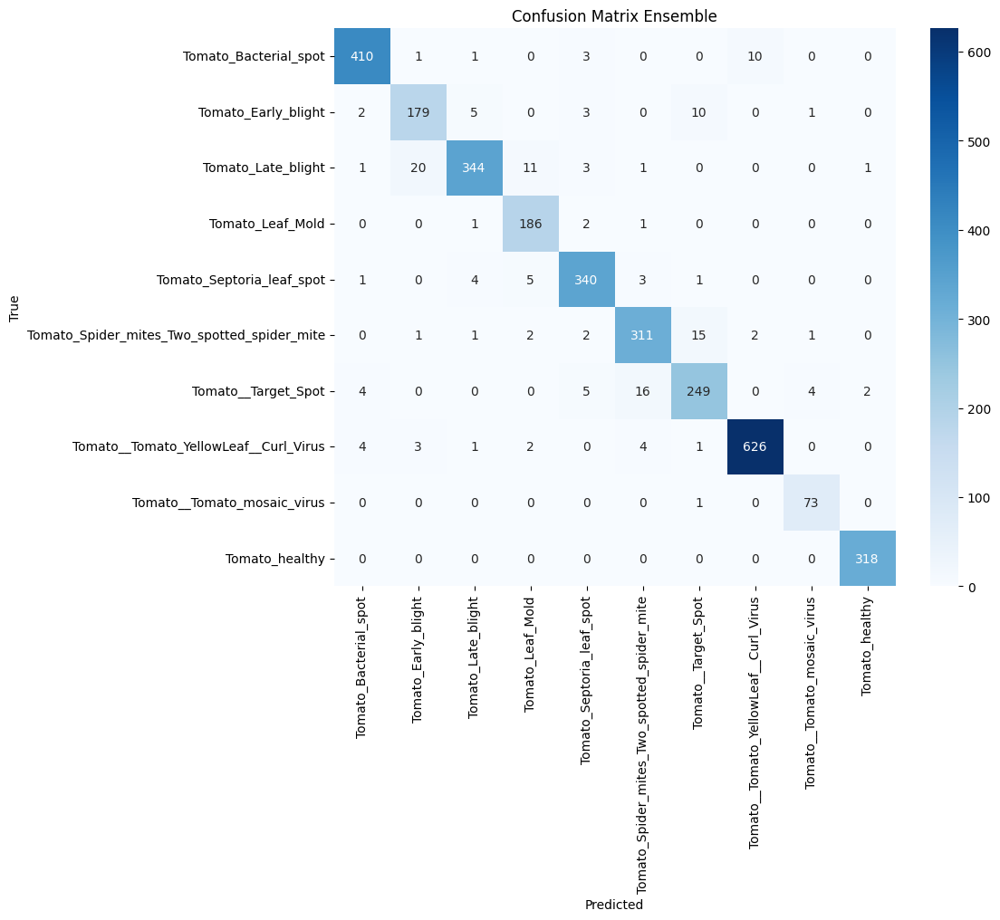

In [8]:
from scipy.stats import mode

models = [load_model(f'best_model_{i}.h5') for i in range(3)]
val_flow.reset()
all_preds = []
for m in models:
    preds = m.predict(val_flow)
    all_preds.append(np.argmax(preds, axis=1))
all_preds = np.array(all_preds)  # shape (n_model, n_data)

voted_preds, _ = mode(all_preds, axis=0)
voted_preds = np.asarray(voted_preds).ravel()  # <= fix di sini!

y_true = val_flow.classes
class_labels = list(val_flow.class_indices.keys())

print('\nENSEMBLE Classification Report')
print(classification_report(y_true, voted_preds, target_names=class_labels))

cm = confusion_matrix(y_true, voted_preds)
plt.figure(figsize=(10,8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix Ensemble')
plt.show()


1. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/121e9cbe-77d2-43ca-8e04-17a556a1c2b2___RS_Erly.B 7512.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


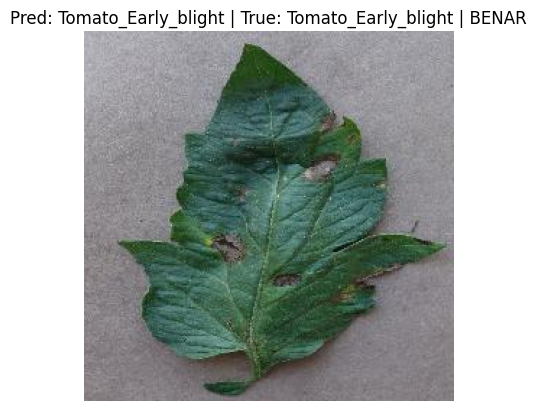

2. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/13ece3d5-a35e-4da2-9390-e58f4aa242e3___UF.GRC_YLCV_Lab 02403.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


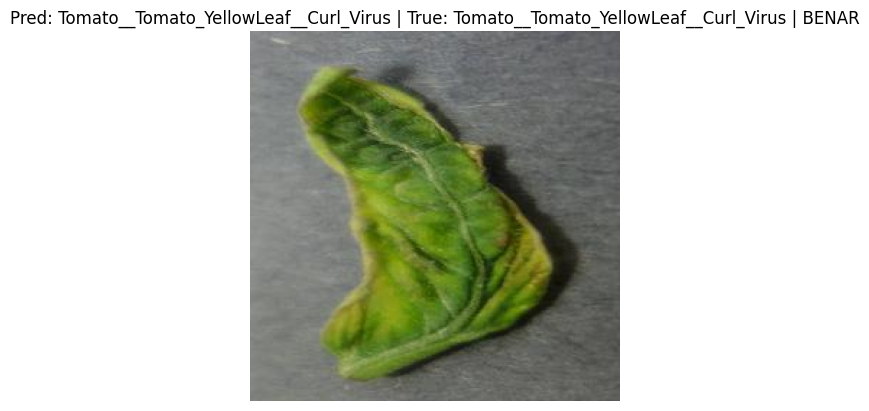

3. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/1aec01f1-6200-4d30-bb9f-30ae5f423a8a___YLCV_GCREC 2709.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


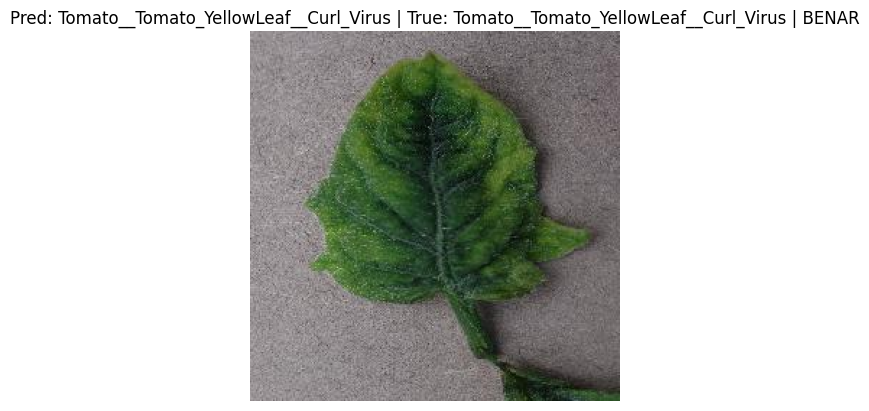

4. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/02dec71c-6051-4b2c-8a08-24efbe306766___YLCV_GCREC 5340.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


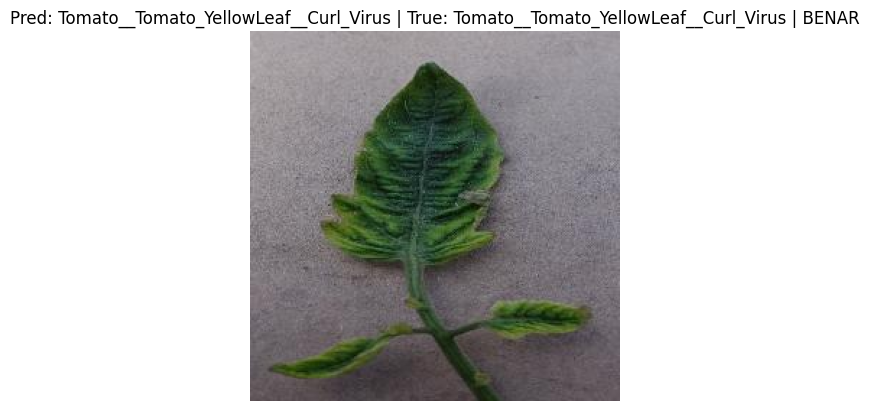

5. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/03028d07-fabb-4524-af78-8919980ed2ac___UF.GRC_YLCV_Lab 03170.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


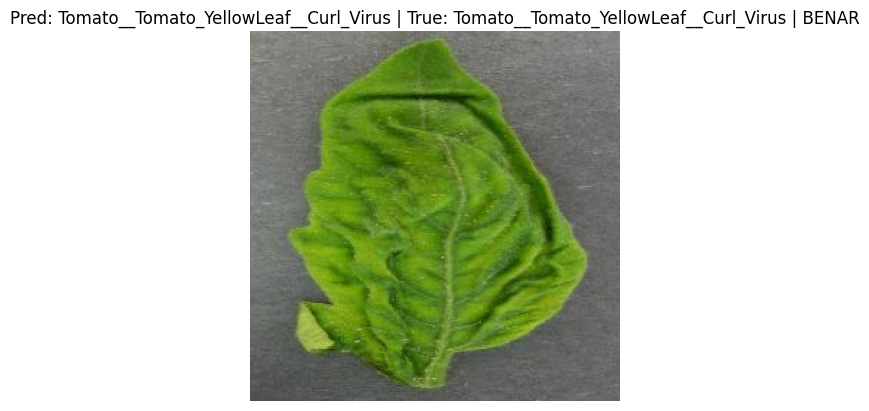

6. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/10c1d7a4-bd14-4961-9b96-c7047589eccd___RS_Erly.B 7552.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


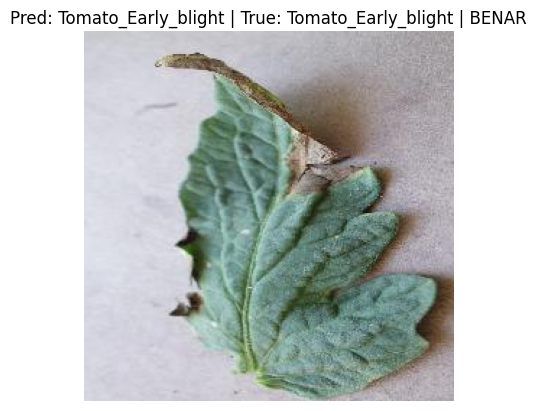

7. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/1aaf8680-14bf-494c-80e7-808f0d3730df___YLCV_GCREC 5151.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato__Tomato_YellowLeaf__Curl_Virus | SALAH


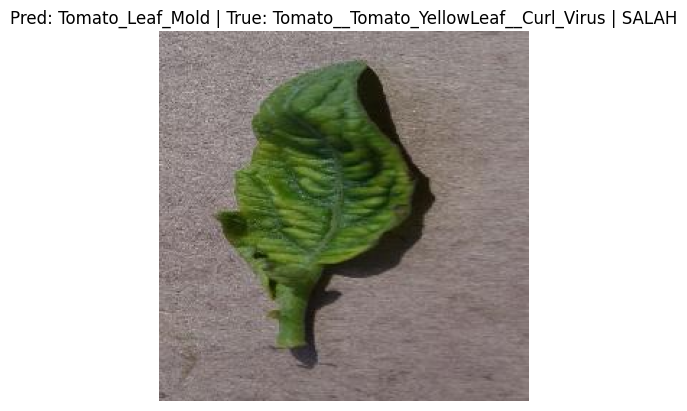

8. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/25281e43-2651-423f-8e7e-d354185ccd28___RS_Erly.B 7809.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


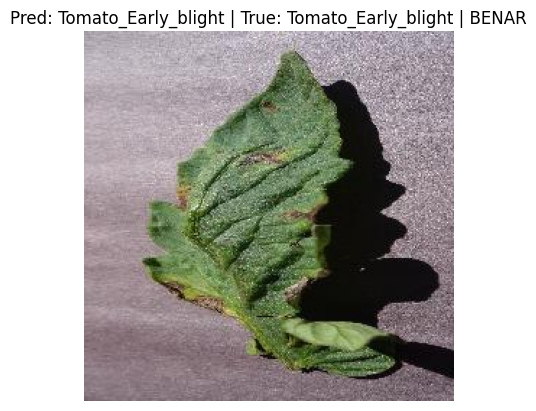

9. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/32231fc1-ec78-45c6-9c7a-8412a7e38a25___GCREC_Bact.Sp 6143.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


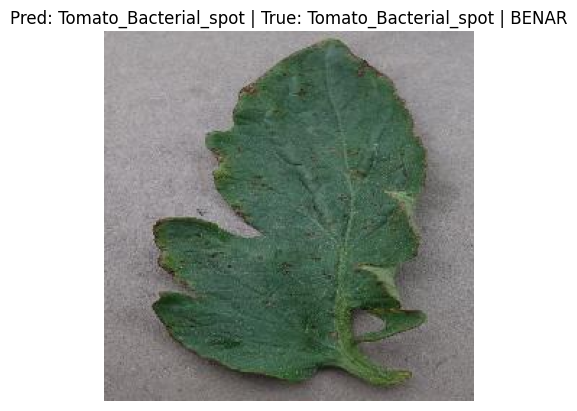

10. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/09560c54-eb85-4f41-b645-df4d114c8f95___Matt.S_CG 6342.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


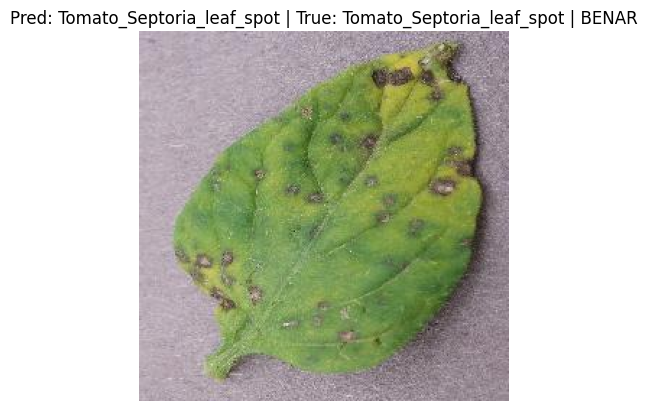

11. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/162156e8-724a-48d9-8a19-904937f9dc03___GCREC_Bact.Sp 3472.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


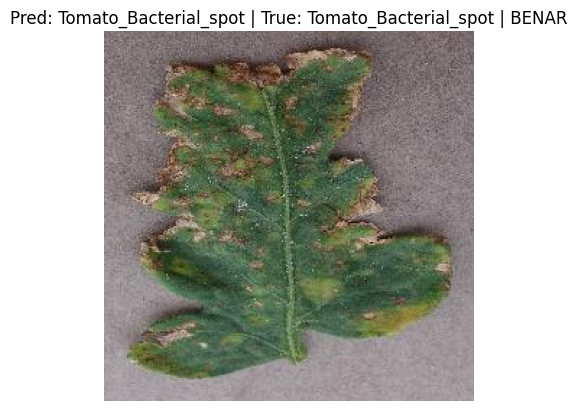

12. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/289972f1-4f80-432d-8f44-39c16ea787c3___RS_Erly.B 7542.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


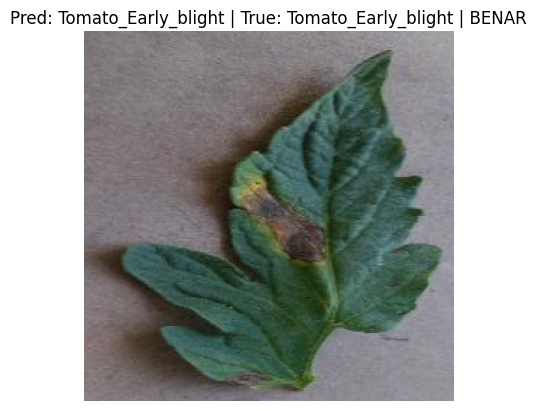

13. /kaggle/input/plantdisease/PlantVillage/Tomato_Leaf_Mold/32902cc7-5db6-4148-8b4e-0d04199edd98___Crnl_L.Mold 6766.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato_Leaf_Mold | BENAR


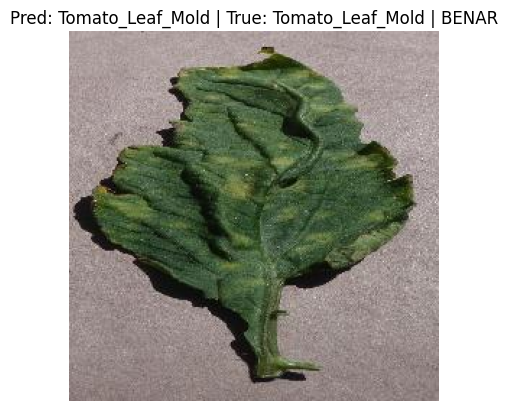

14. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/08a723e4-6b51-4395-8013-b1f3f03709b8___GHLB2 Leaf 8967.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


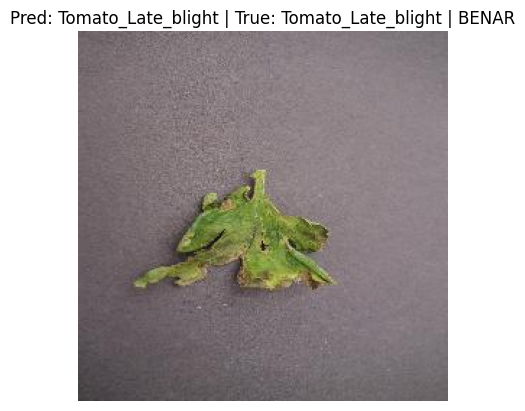

15. /kaggle/input/plantdisease/PlantVillage/Tomato_Leaf_Mold/13611825-494e-4068-8be4-68de001adbf8___Crnl_L.Mold 6965.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato_Leaf_Mold | BENAR


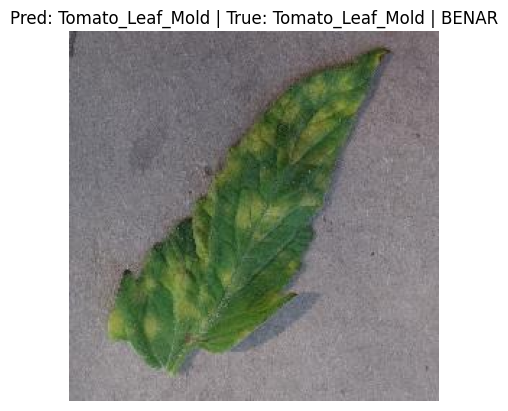

16. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/2fa6cd46-eb76-481e-b15a-44c858f705b3___RS_Erly.B 9532.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


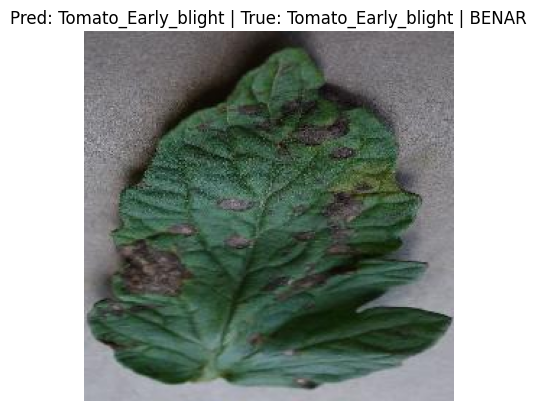

17. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/0fbc786c-62a7-44f3-8db8-2649809bf1aa___RS_Erly.B 9514.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


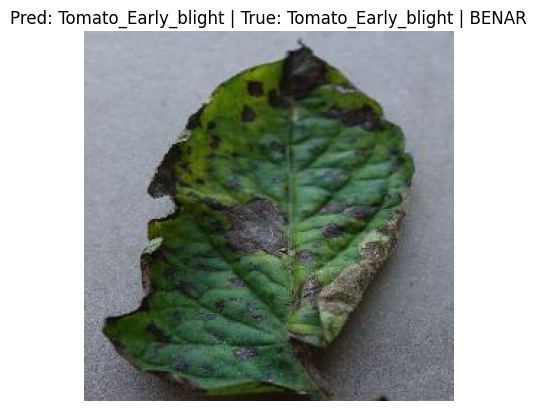

18. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/3331b5a5-229a-416e-9605-c279ec0cf414___Com.G_SpM_FL 1768.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


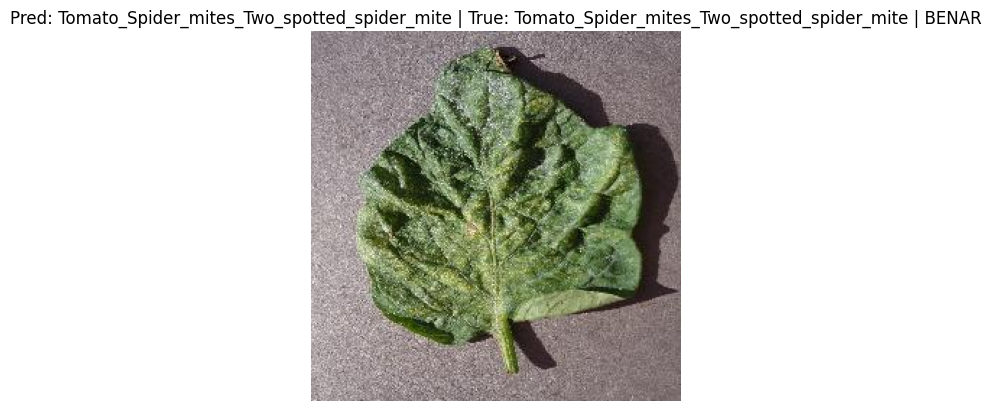

19. /kaggle/input/plantdisease/PlantVillage/Tomato_healthy/0f5a5880-c1f1-4356-8336-d65c69b54cc1___GH_HL Leaf 380.1JPG.JPG | Prediksi: Tomato_healthy | True: Tomato_healthy | BENAR


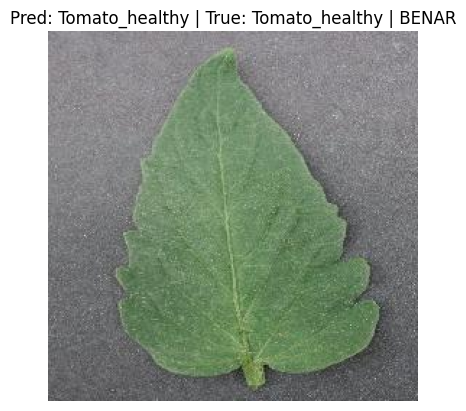

20. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/1a5c3b6d-82ff-4f9b-9ba9-575a493ed3d9___UF.GRC_YLCV_Lab 02684.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


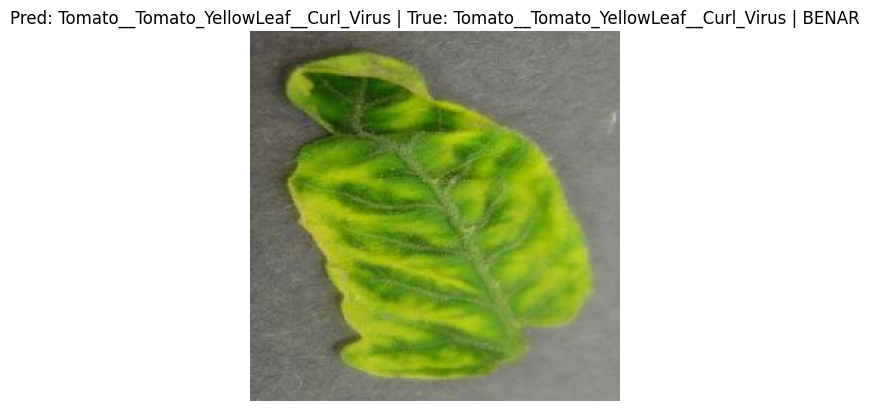

21. /kaggle/input/plantdisease/PlantVillage/Tomato__Target_Spot/3629c94e-1f71-4ec6-91e6-7b3f327c199b___Com.G_TgS_FL 8301.JPG | Prediksi: Tomato__Target_Spot | True: Tomato__Target_Spot | BENAR


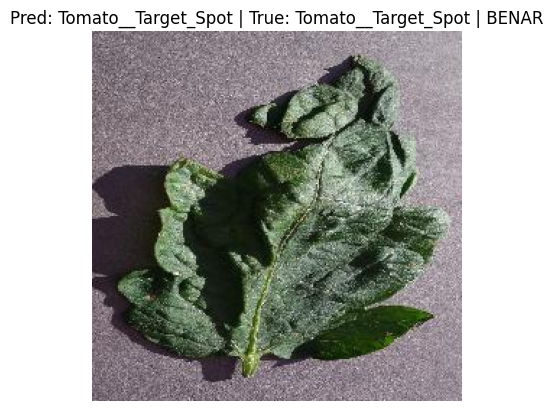

22. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/19a19d0b-373f-497a-89bf-ea941ff5e12b___GCREC_Bact.Sp 3124.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


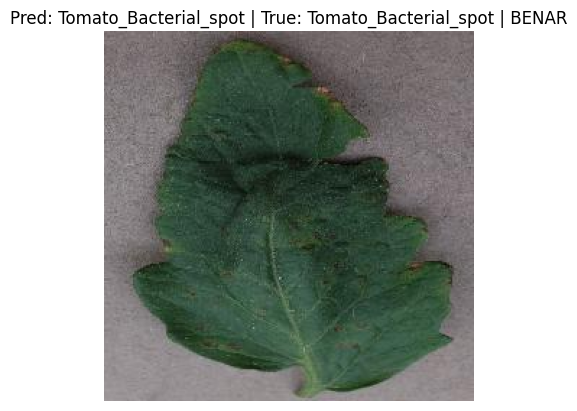

23. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/307b1e1b-4a5c-4378-91df-df121d7e4f51___Matt.S_CG 7667.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


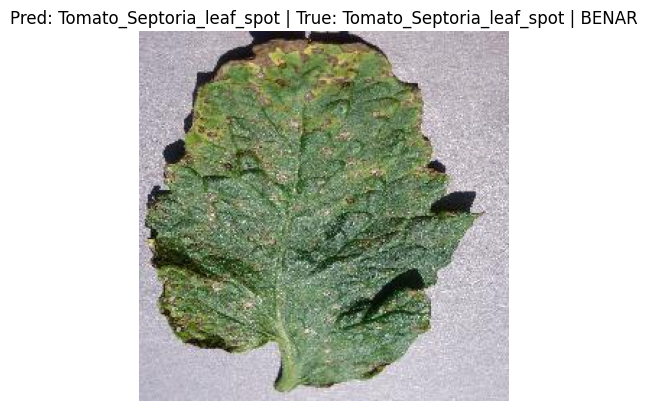

24. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/0b13b997-9957-4029-b2a4-ef4a046eb088___UF.GRC_BS_Lab Leaf 0595.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


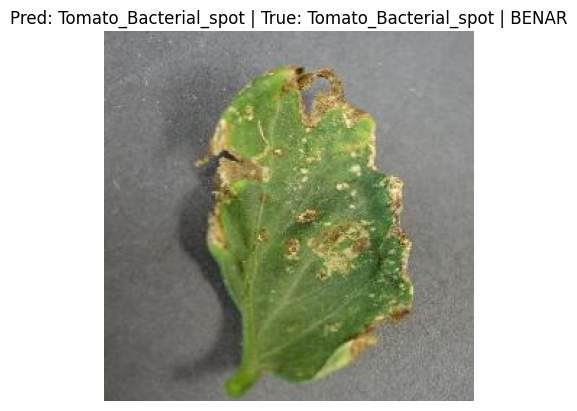

25. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/06f654df-cf43-4fd6-b30f-78425136bc35___GHLB2 Leaf 86.2.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


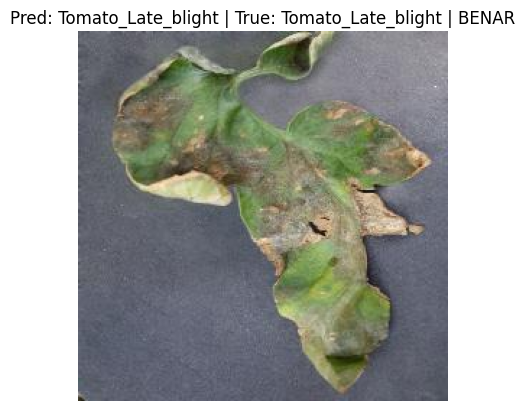

26. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/2f433332-c89a-482b-993b-37a3a10096e0___GHLB2 Leaf 8616.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


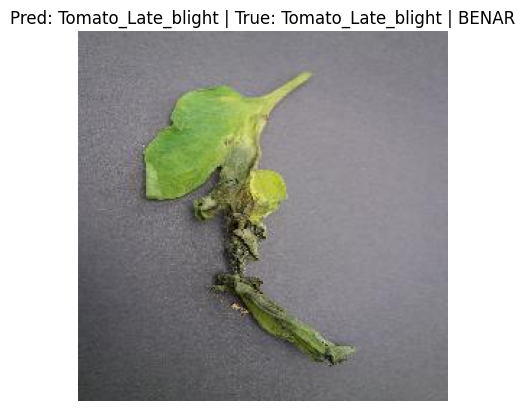

27. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/246bf675-01a0-4da1-90ab-a1b44d3768dd___Com.G_SpM_FL 8635.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


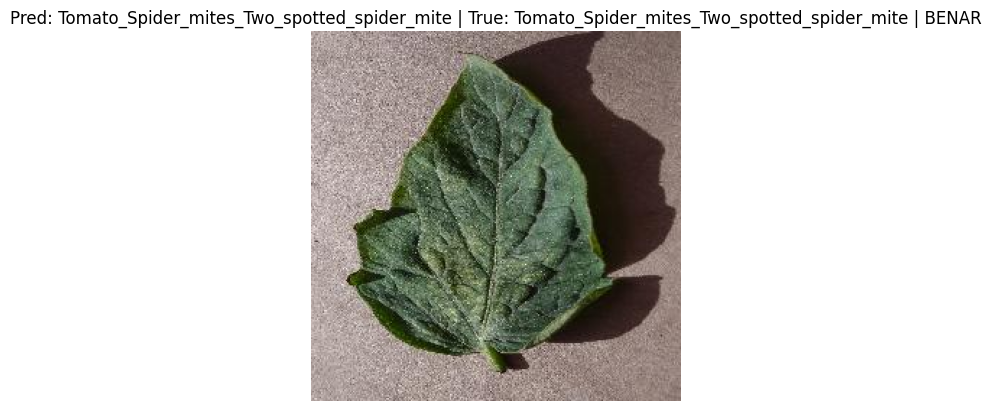

28. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/01d9fc8d-5083-468d-a583-885f33517cdd___GCREC_Bact.Sp 3422.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


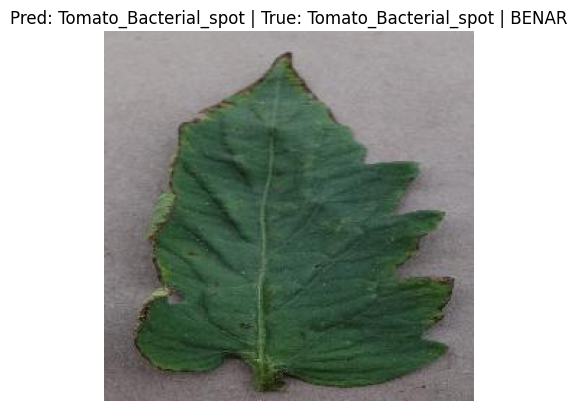

29. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/22c8fb41-70e6-4fcc-b77b-81511cba9001___Matt.S_CG 1512.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


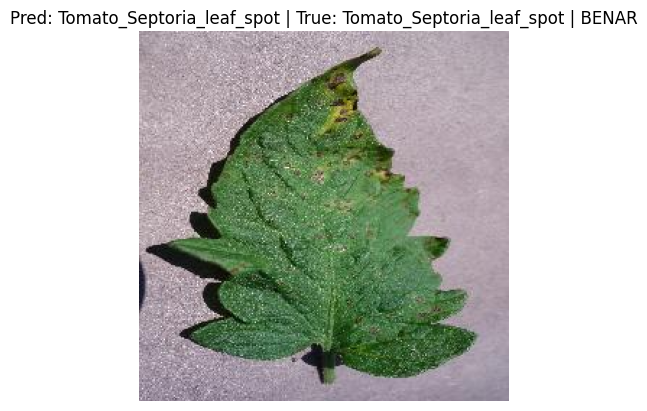

30. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/0d173b50-c743-4422-99d1-48a0069518db___UF.GRC_YLCV_Lab 03204.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


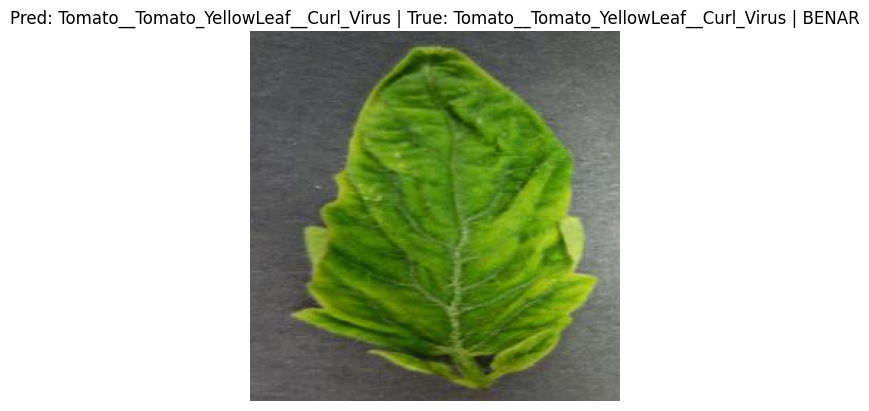

31. /kaggle/input/plantdisease/PlantVillage/Tomato_healthy/2a11ceb9-41c9-4f2e-bed9-ef1c1c7d479b___RS_HL 0371.JPG | Prediksi: Tomato_healthy | True: Tomato_healthy | BENAR


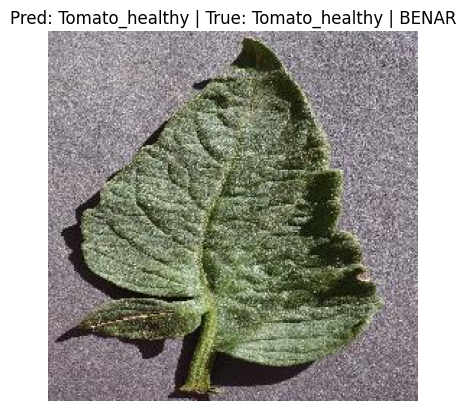

32. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/2312305e-c167-4730-a07a-db5c9956077a___RS_Erly.B 7752.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


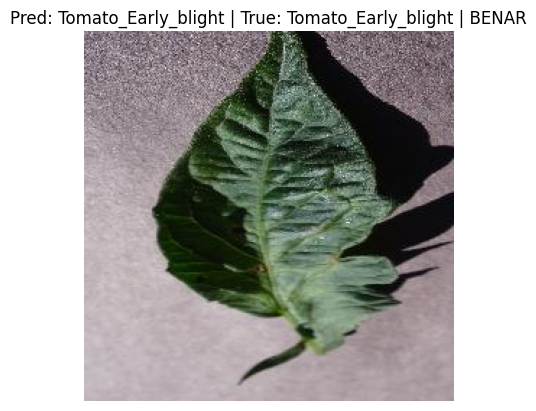

33. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/25a83fb3-e27a-419c-a9db-652fae319fcd___RS_Late.B 6191.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


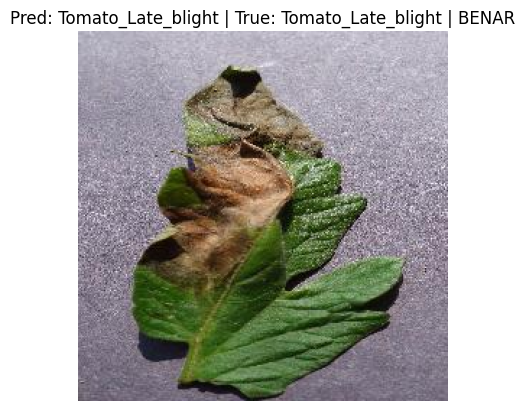

34. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/121b3f84-70ed-4d1c-882c-d3204e2af046___RS_Erly.B 8421.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Early_blight | SALAH


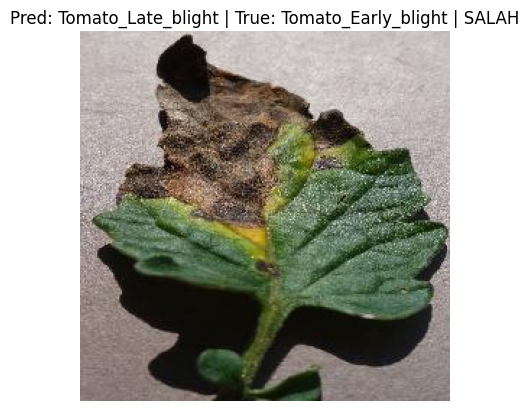

35. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/1a3965e0-423a-4003-ae8d-2fb639d02008___JR_Sept.L.S 8449.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


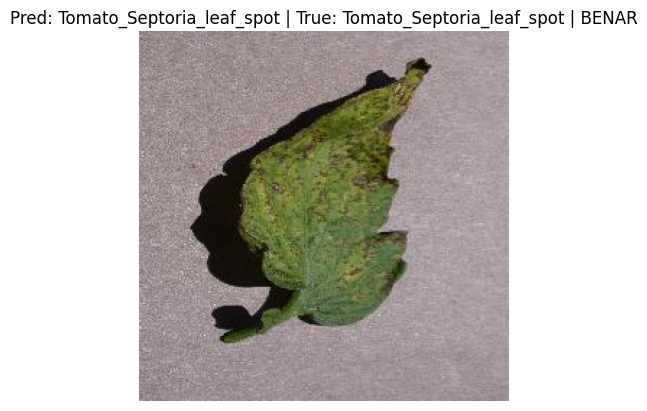

36. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/0893ac69-4004-4577-b4aa-496983116208___GHLB2 Leaf 8738.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


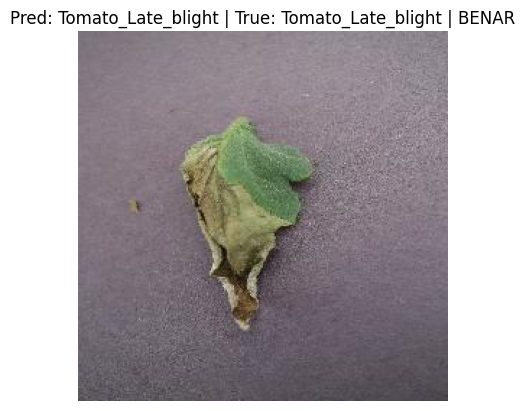

37. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/180ef991-3ed2-41d8-93b6-c1791d745669___UF.GRC_YLCV_Lab 01678.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


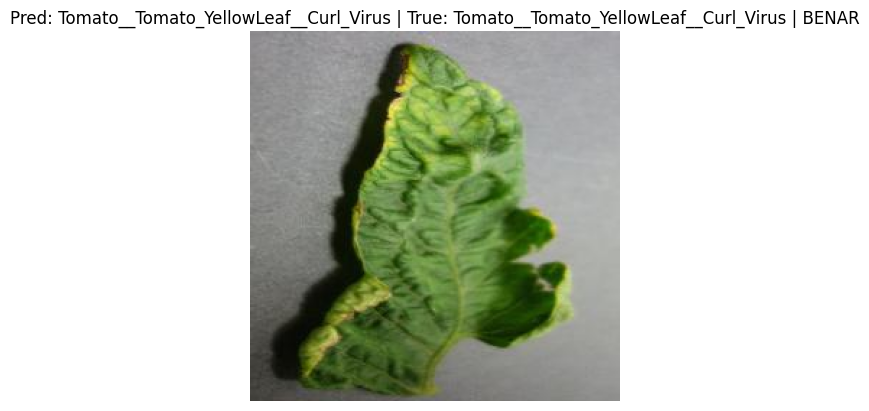

38. /kaggle/input/plantdisease/PlantVillage/Tomato__Target_Spot/04877a47-d7e8-461d-b943-00099f3a2a95___Com.G_TgS_FL 0838.JPG | Prediksi: Tomato__Target_Spot | True: Tomato__Target_Spot | BENAR


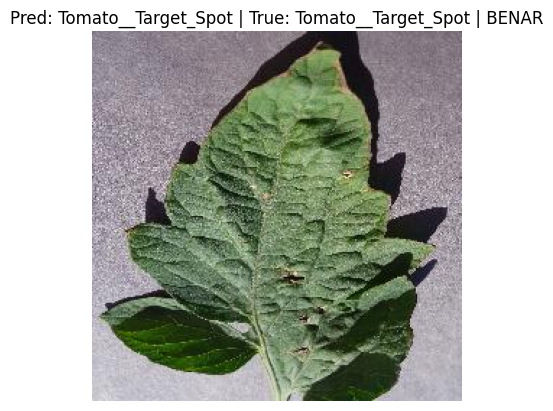

39. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/288f203e-7996-4290-afa7-f95c0c30506a___RS_Late.B 5562.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


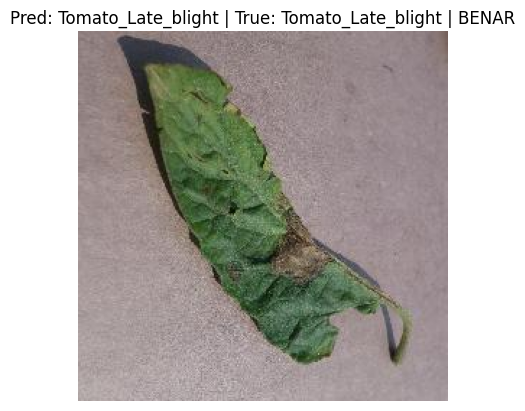

40. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/012369f5-ca64-4811-888f-35d75f7f7c2b___Com.G_SpM_FL 8911.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


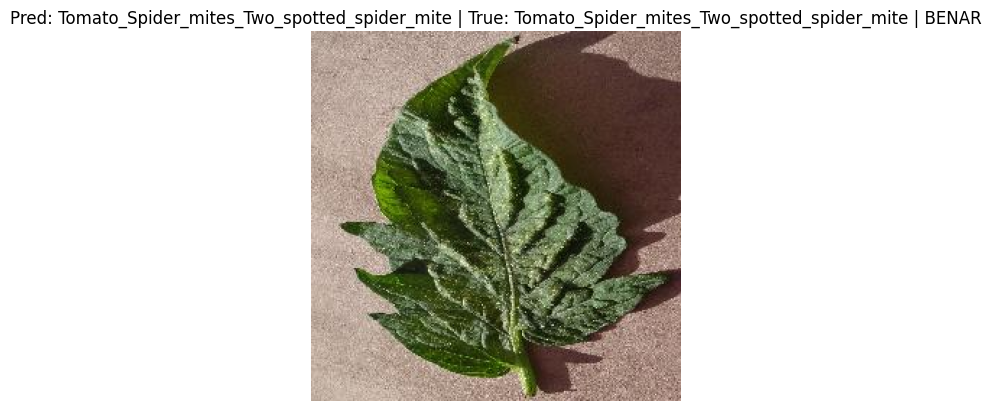

41. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/1d2bcd85-fdb7-4294-ba11-eb58373b4474___GCREC_Bact.Sp 3092.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


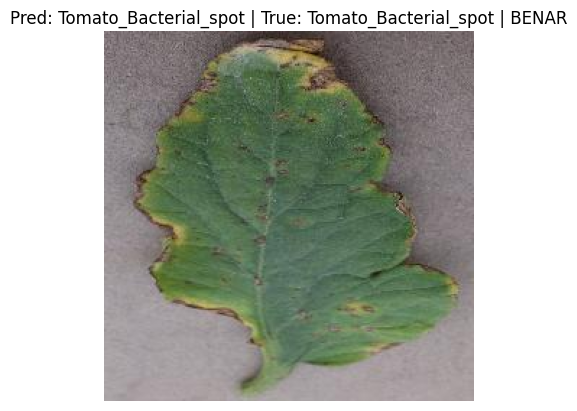

42. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_mosaic_virus/155b3b3a-2eab-4b55-aa3c-bb8d7b53b624___PSU_CG 2302.JPG | Prediksi: Tomato__Tomato_mosaic_virus | True: Tomato__Tomato_mosaic_virus | BENAR


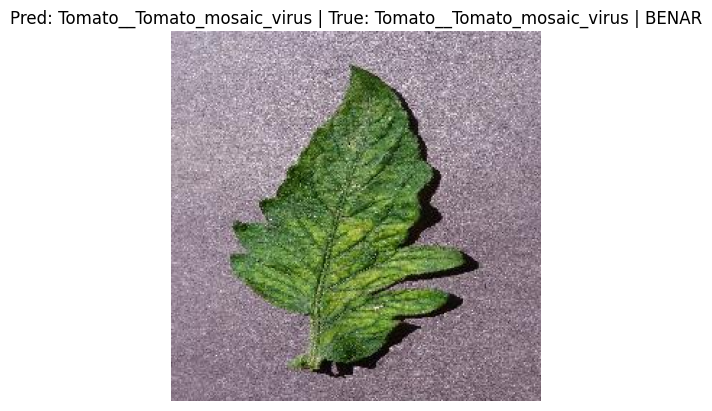

43. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/26d22895-7a72-4e27-99b7-222618d69b7b___RS_Late.B 5111.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


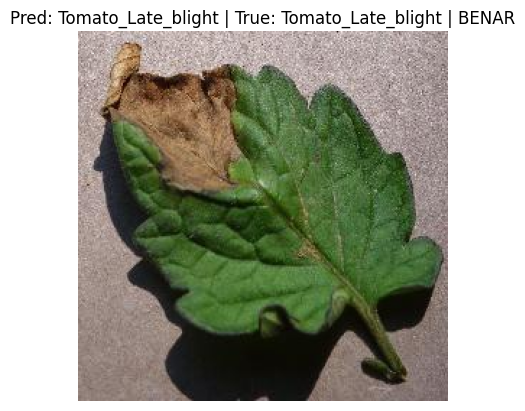

44. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/326d232c-21f1-44c0-91a2-ce202460af8d___Com.G_SpM_FL 1360.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


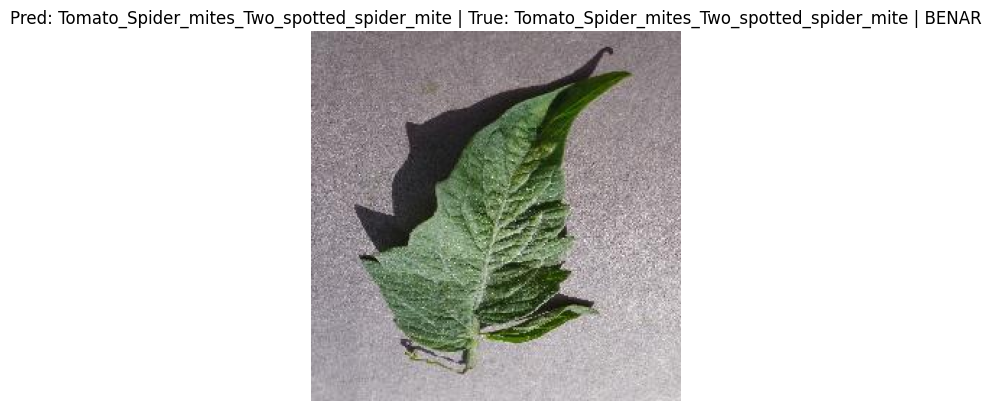

45. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/25e772ed-0fc2-437d-b573-5edd92bf441e___Com.G_SpM_FL 8559.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


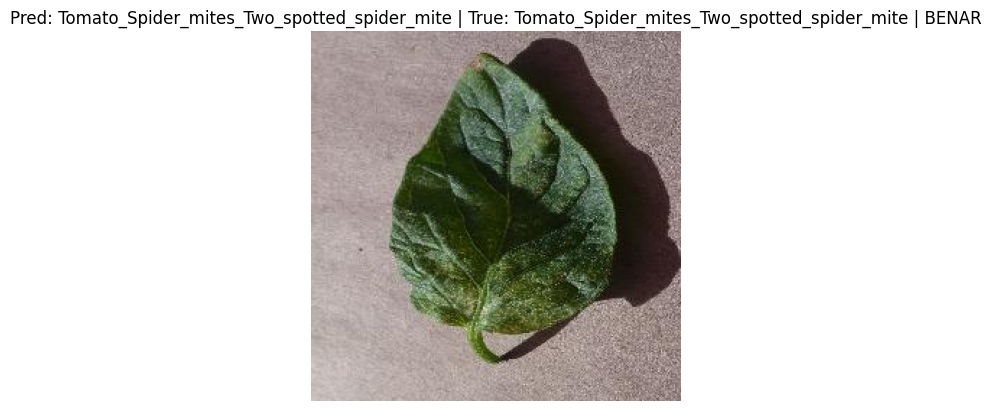

46. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/0808b0d2-02be-4845-b713-276f9b9ab890___YLCV_GCREC 5474.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


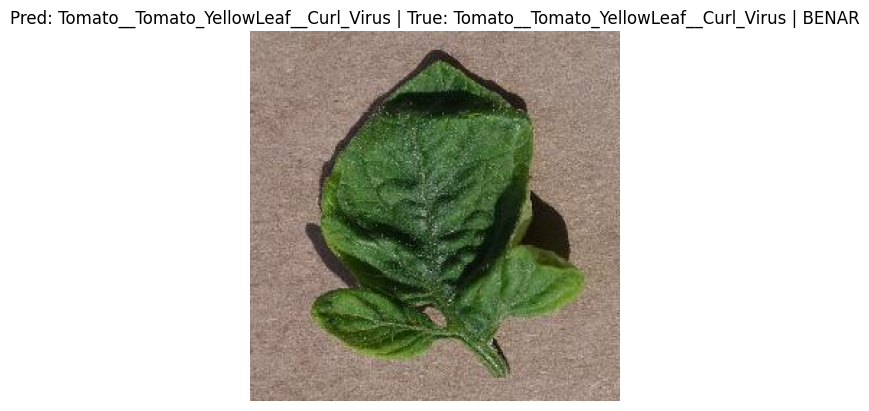

47. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/0f57cc30-af42-4543-9a67-b27eda784325___UF.GRC_BS_Lab Leaf 9260.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


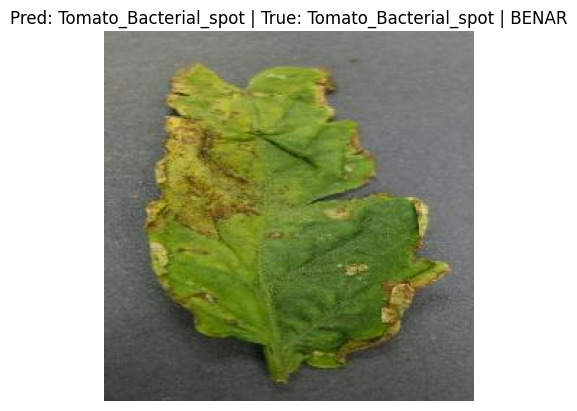

48. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/1d71aaf7-0c50-4668-818f-1481a1c367cd___YLCV_GCREC 2857.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


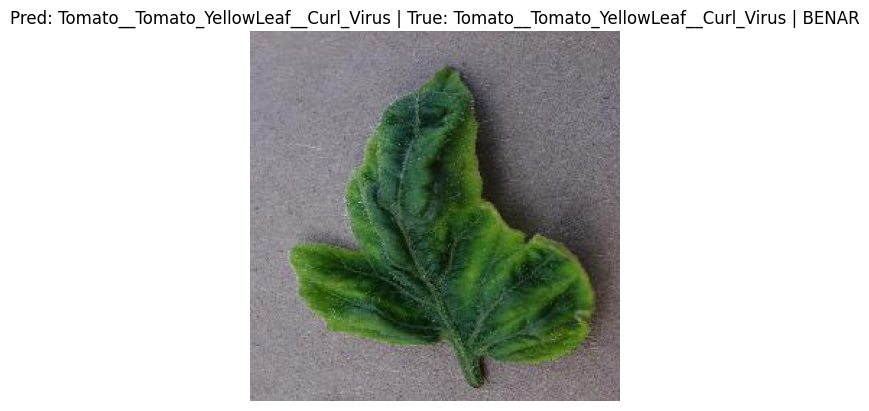

49. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_mosaic_virus/1f675039-385d-4438-b157-db0c95673580___PSU_CG 2100.JPG | Prediksi: Tomato__Tomato_mosaic_virus | True: Tomato__Tomato_mosaic_virus | BENAR


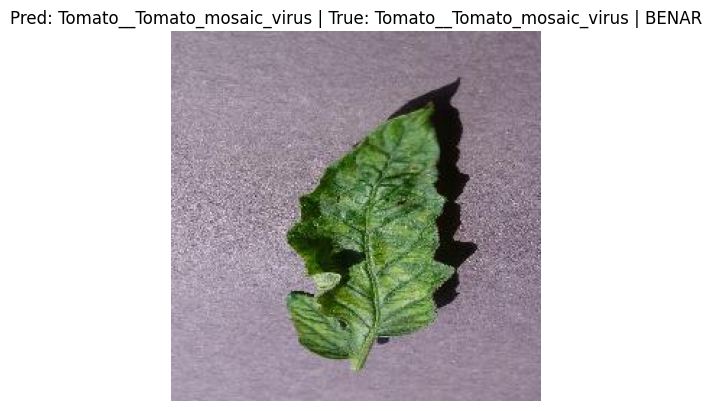

50. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/20a276c8-90b5-475f-811b-1d63f34f1c10___RS_Erly.B 9551.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


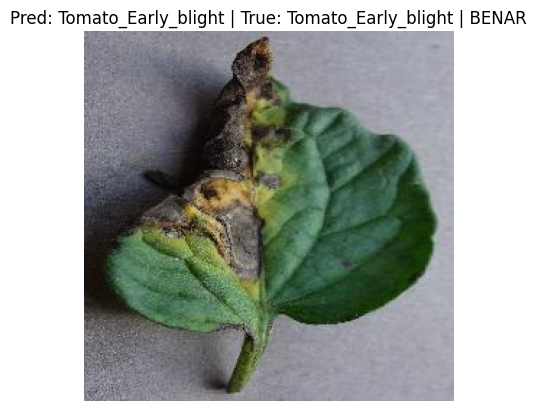

51. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/29a61150-5453-4a76-88eb-2e97a8f4c400___GCREC_Bact.Sp 6345.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


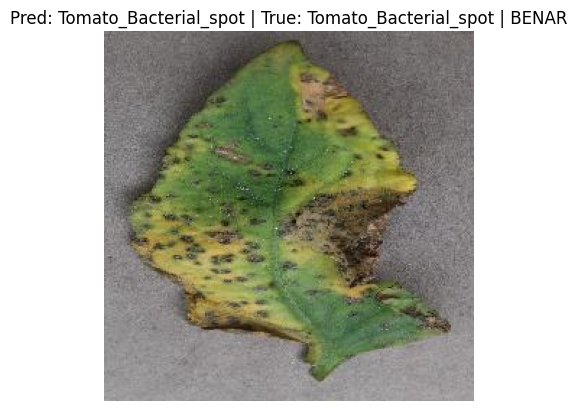

52. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/2832ca53-be67-44c0-ac55-eb815bd85fd3___RS_Erly.B 8242.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


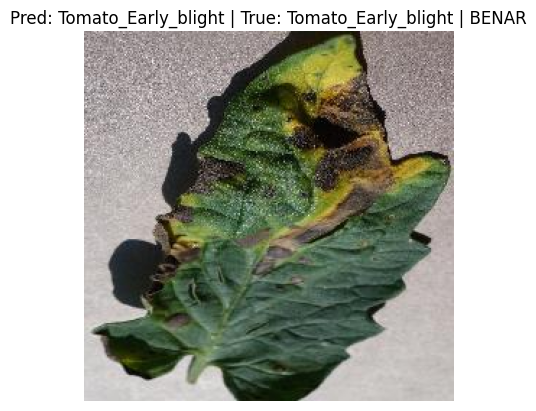

53. /kaggle/input/plantdisease/PlantVillage/Tomato_healthy/27c1515c-743f-4f4d-8342-fbe3cee29e7e___RS_HL 0344.JPG | Prediksi: Tomato_healthy | True: Tomato_healthy | BENAR


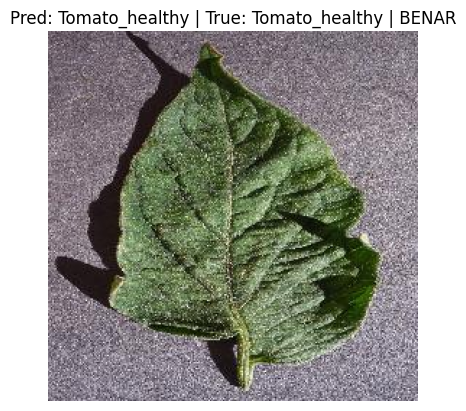

54. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/0cd1ebaf-3975-4749-b625-50b7b0751c36___RS_Erly.B 7508.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


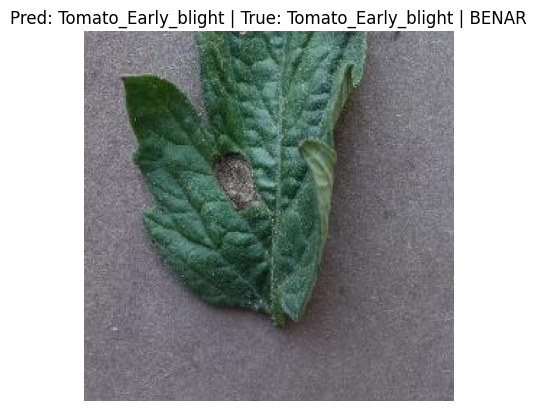

55. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/07897854-c2ab-465b-8cf7-a134b6066a1c___GHLB Leaf 1.1 Day 6.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


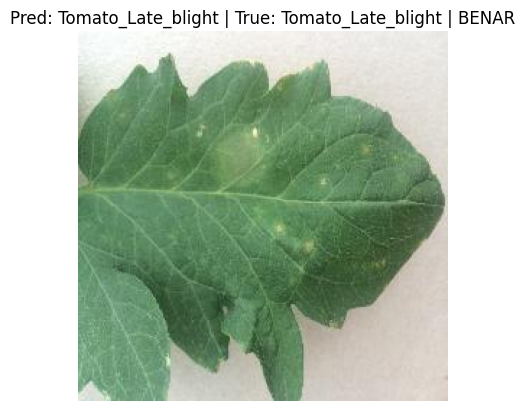

56. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/3138a911-db1c-4462-a282-ec266c555c07___Matt.S_CG 7541.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


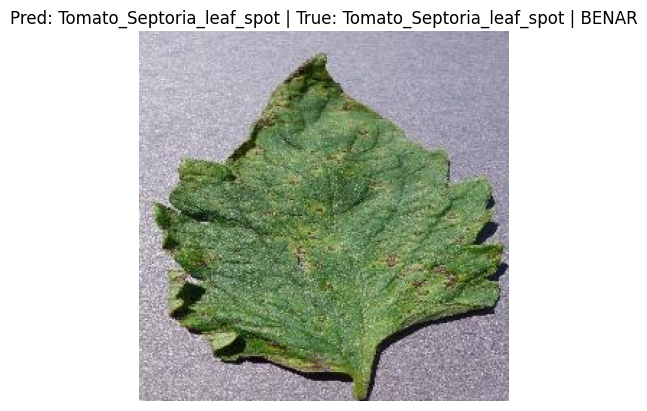

57. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/2365ce1e-195c-4cf9-a38d-927f0faa489a___JR_Sept.L.S 2725.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


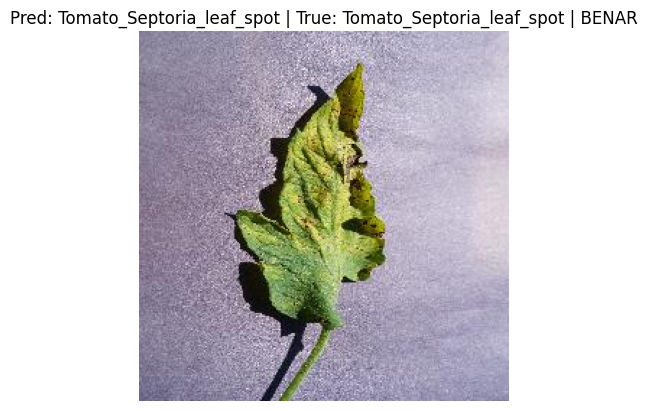

58. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/0e05cc2b-1209-4a5a-9ae1-26b3dd13204b___Com.G_SpM_FL 8428.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


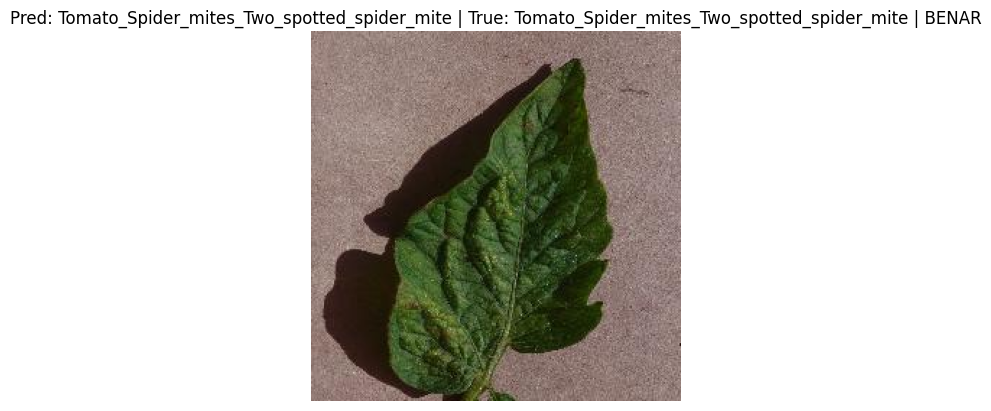

59. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/0a9560c4-1430-4514-93c4-7036f6fee43d___UF.GRC_YLCV_Lab 01280.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


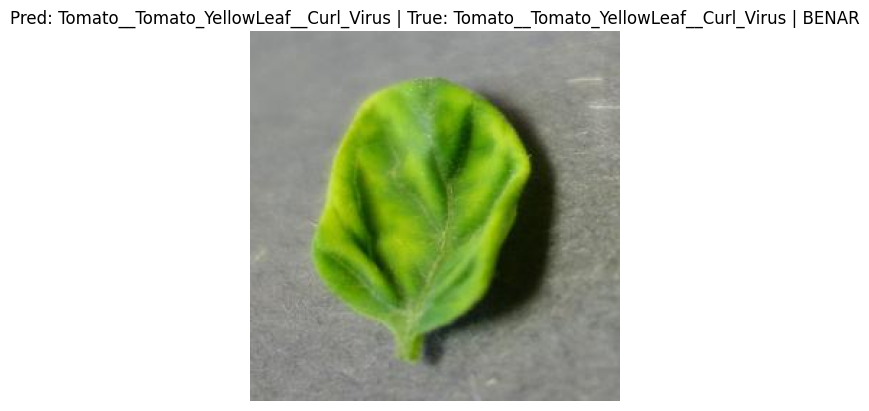

60. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/0d6a202a-046f-47b2-beec-cc6a1e7deae6___Com.G_SpM_FL 8937.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


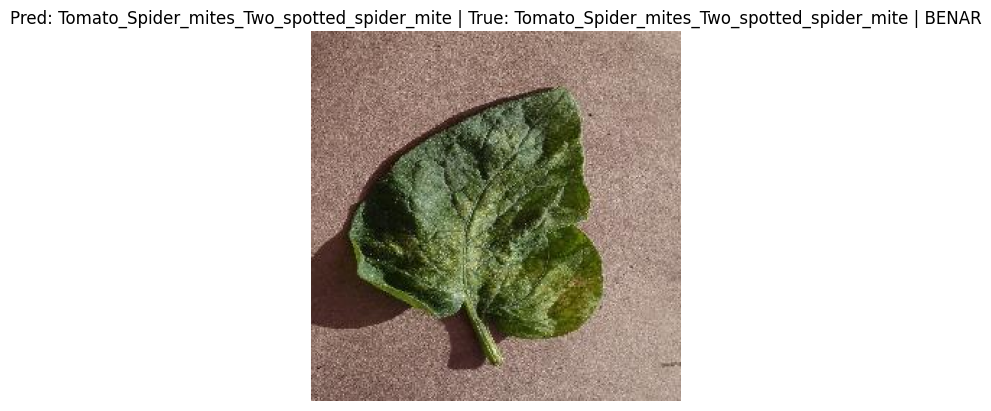

61. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/099b0332-14bf-4866-8c3b-e753e7e62105___YLCV_NREC 2398.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


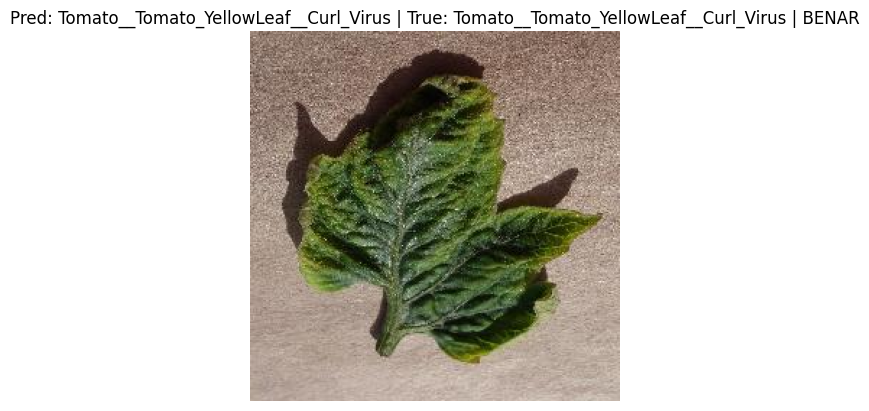

62. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/1d3d164e-43a9-4e0a-9e4f-9c9abab64d88___RS_Erly.B 7824.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


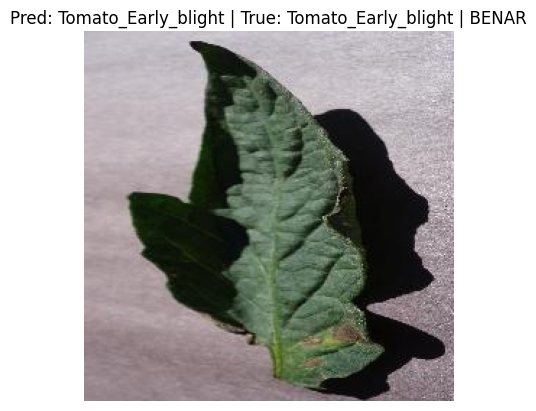

63. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/01527fac-41e4-484c-af41-1ed7bc3b5ce6___RS_Late.B 6134.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato_Late_blight | SALAH


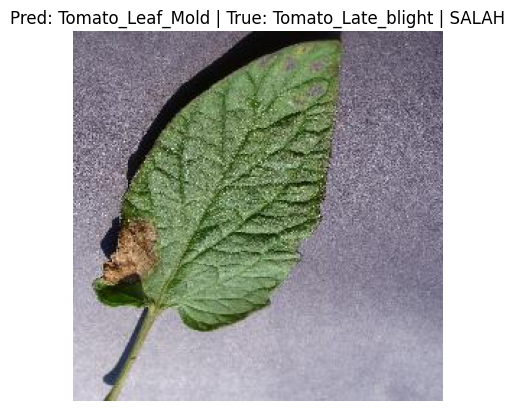

64. /kaggle/input/plantdisease/PlantVillage/Tomato__Target_Spot/27f8886b-9562-4607-a487-899046382f11___Com.G_TgS_FL 7899.JPG | Prediksi: Tomato__Target_Spot | True: Tomato__Target_Spot | BENAR


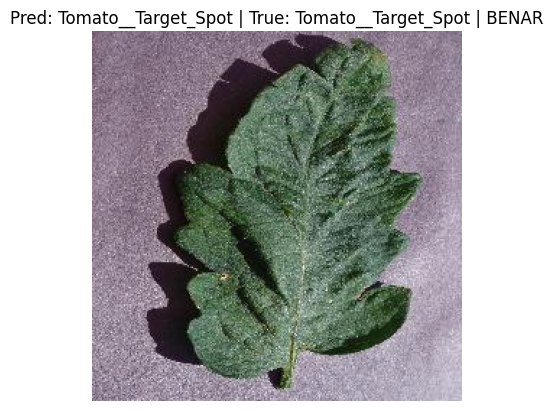

65. /kaggle/input/plantdisease/PlantVillage/Tomato_healthy/1479f22a-c0d6-4dac-a752-578f575f276d___GH_HL Leaf 173.5.JPG | Prediksi: Tomato_healthy | True: Tomato_healthy | BENAR


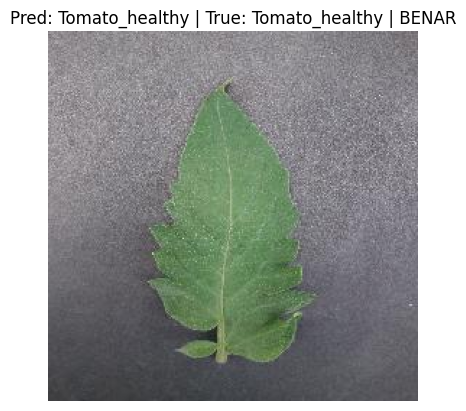

66. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/0da23640-656e-4f03-be14-4b4b36811861___GHLB2 Leaf 9072.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


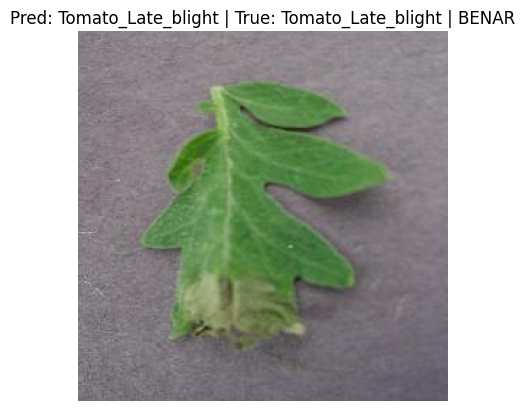

67. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_mosaic_virus/29bbbfcc-76ef-4506-9c1b-1a749646856e___PSU_CG 2184.JPG | Prediksi: Tomato__Tomato_mosaic_virus | True: Tomato__Tomato_mosaic_virus | BENAR


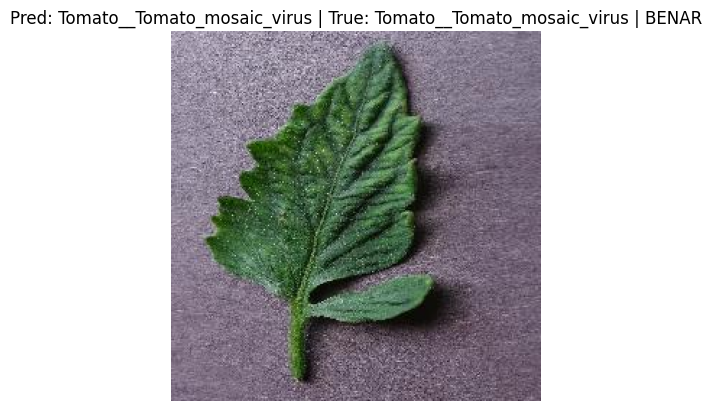

68. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/13b9cfb4-eb4a-4dc8-b005-705687b4cf53___UF.GRC_YLCV_Lab 02602.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


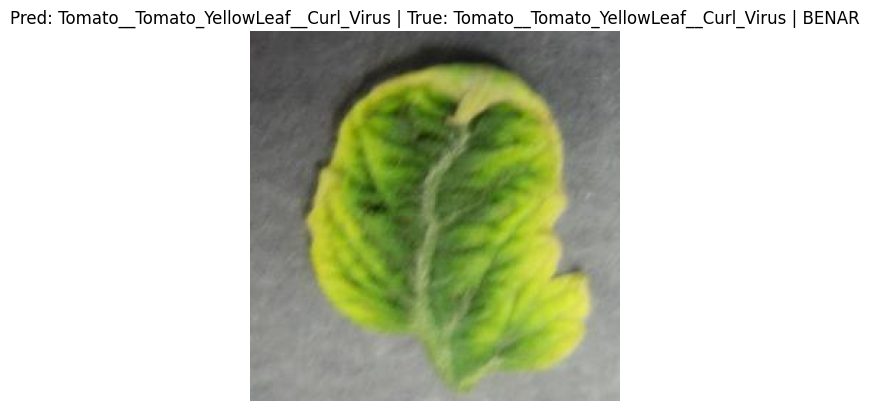

69. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/10742761-050e-4a3b-b3ef-cbbde8cd6d2a___Com.G_SpM_FL 8445.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


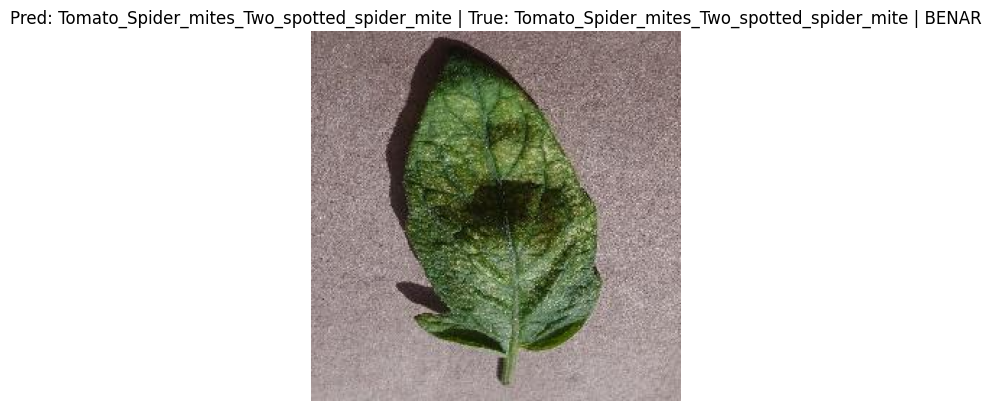

70. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/2d583f2c-3e59-4c4c-be45-5f367a38af95___GHLB2 Leaf 8724.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


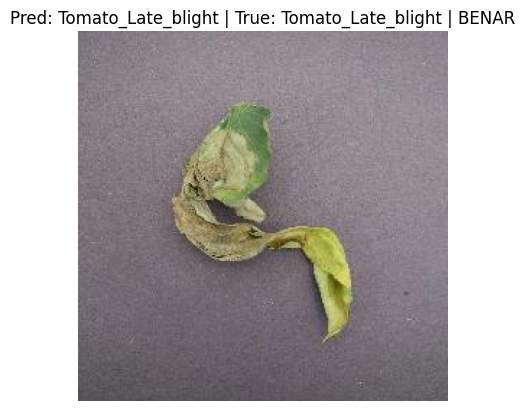

71. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/283ff0be-6e5e-4b4e-bf21-639780b77ffc___GHLB2 Leaf 8636.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


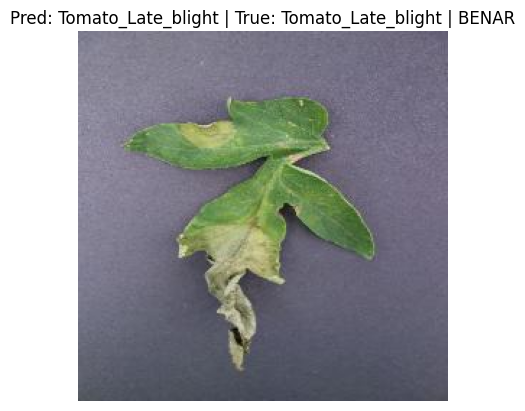

72. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/050c429f-7779-4952-8911-d4d255e00295___YLCV_GCREC 2868.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


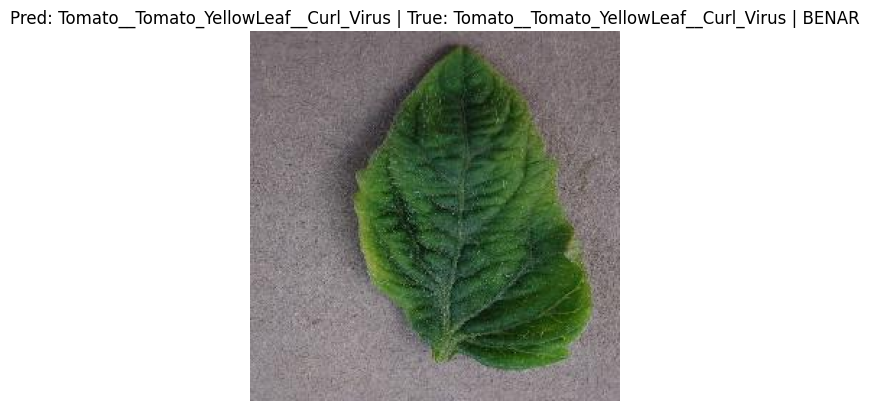

73. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/1120ddb9-d30f-4683-adf6-a30779648b49___GCREC_Bact.Sp 3408.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


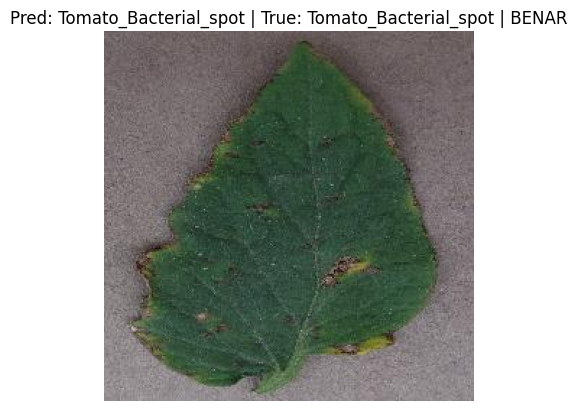

74. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/11922494-321b-4742-afbe-f6db6a8b4005___RS_Erly.B 9392.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


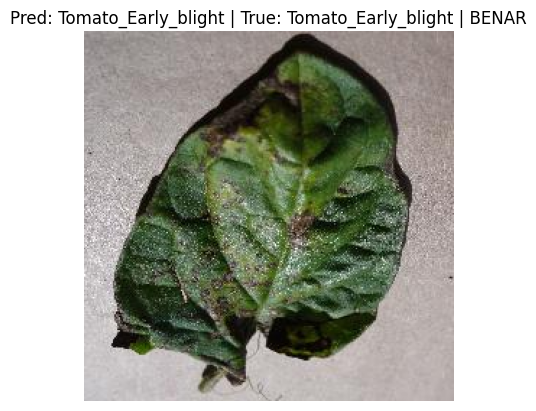

75. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/04c4e77c-7346-4f27-ac7b-48273cbfb965___UF.GRC_YLCV_Lab 03292.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


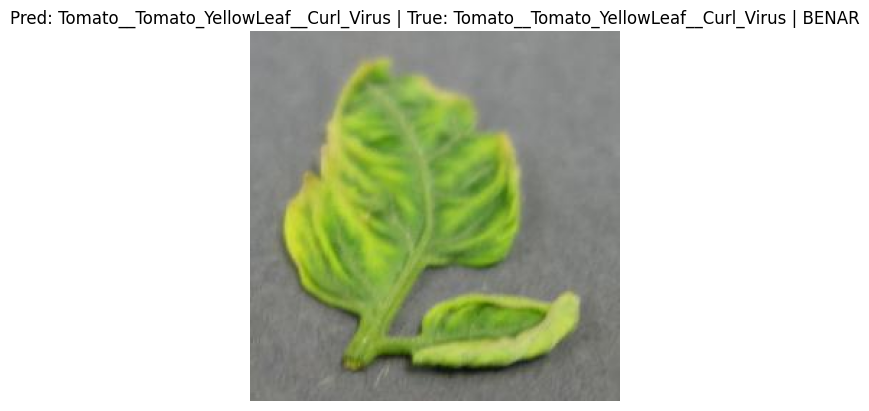

76. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/0e39c18a-9e04-4f6b-b557-dc0e944d22e5___RS_Erly.B 9501.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


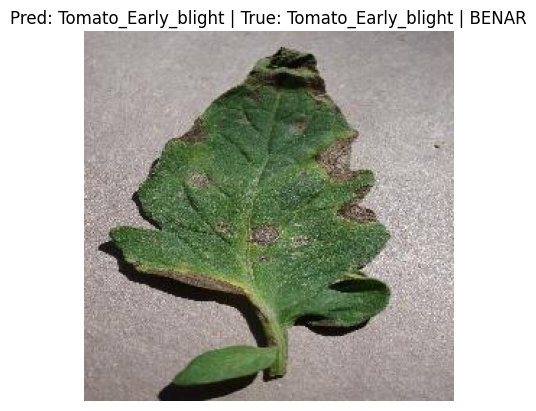

77. /kaggle/input/plantdisease/PlantVillage/Tomato_Leaf_Mold/10671d95-f882-4e19-994f-b35917d2c763___Crnl_L.Mold 9098.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato_Leaf_Mold | BENAR


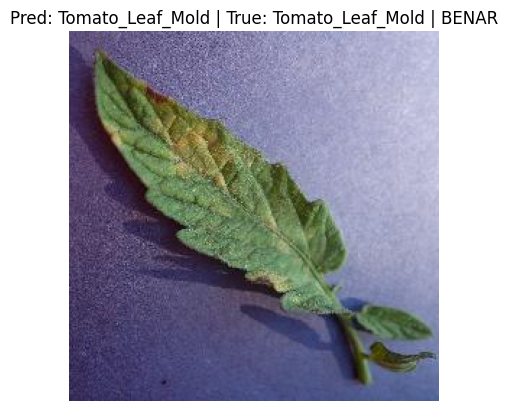

78. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/173f882f-3ba1-49d2-ab0d-ca8232baf2a5___Matt.S_CG 6133.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


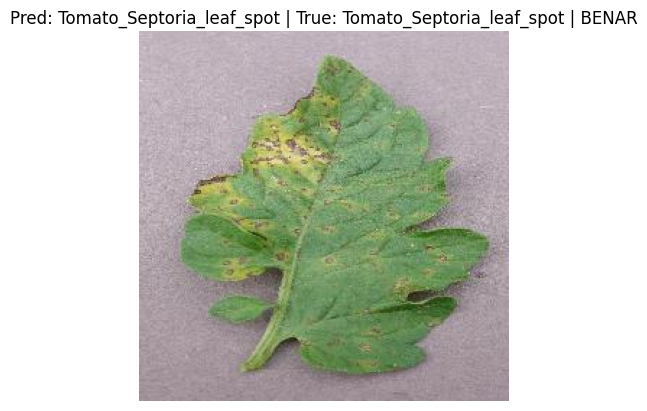

79. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/1747e771-a2c7-43e0-a158-02a78ec13d74___Com.G_SpM_FL 9625.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Spider_mites_Two_spotted_spider_mite | SALAH


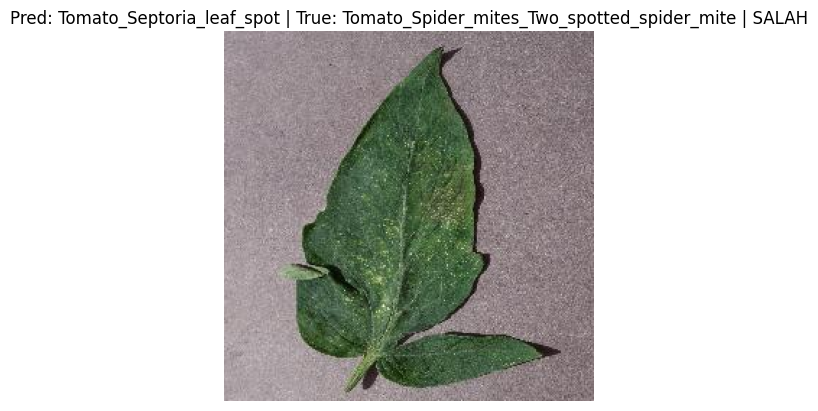

80. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/10c418e8-59b3-4d9f-a22b-7762b538e758___UF.GRC_BS_Lab Leaf 0900.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


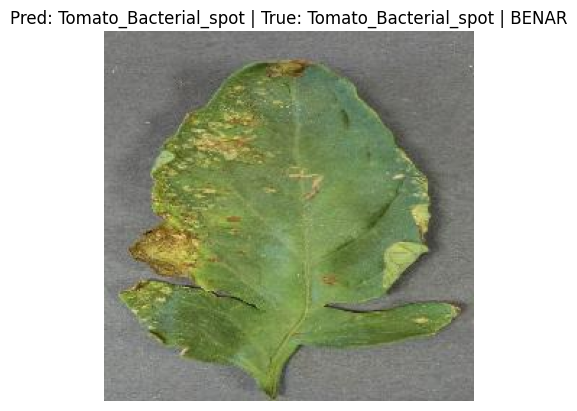

81. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/17c7e5bd-f44e-4dbd-9cd0-f0dbcc654306___JR_Sept.L.S 8557.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


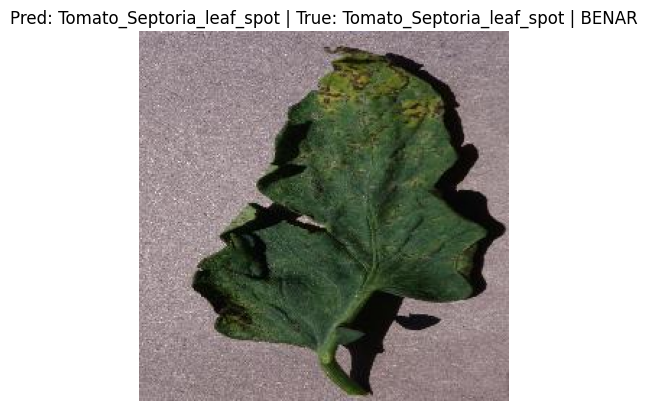

82. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/06d98f32-c416-4a79-81df-8e64f8bb7779___GCREC_Bact.Sp 3083.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


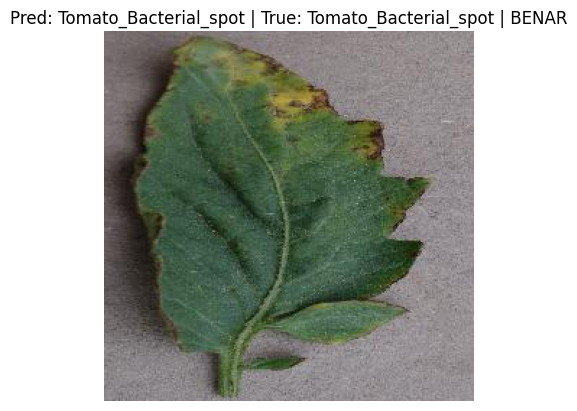

83. /kaggle/input/plantdisease/PlantVillage/Tomato__Target_Spot/04a27dd5-fdd0-40b7-aa5a-527e15f84a99___Com.G_TgS_FL 9679.JPG | Prediksi: Tomato__Target_Spot | True: Tomato__Target_Spot | BENAR


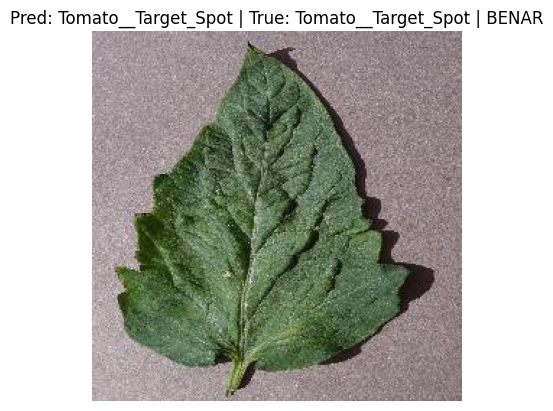

84. /kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/0e03c87e-b43f-4cfe-a837-71306c68f4c0___RS_Erly.B 7733.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Early_blight | BENAR


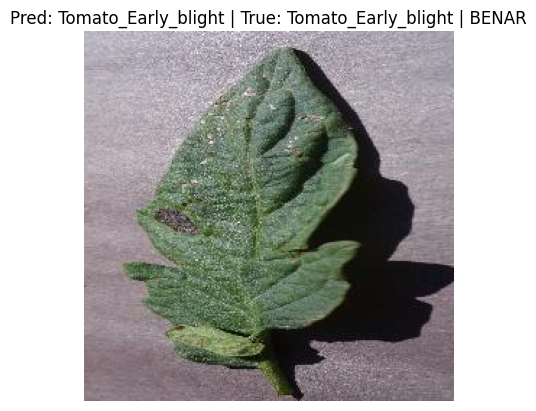

85. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/1d2c329f-db43-4e47-b3bc-93f84ec812cc___YLCV_NREC 2310.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


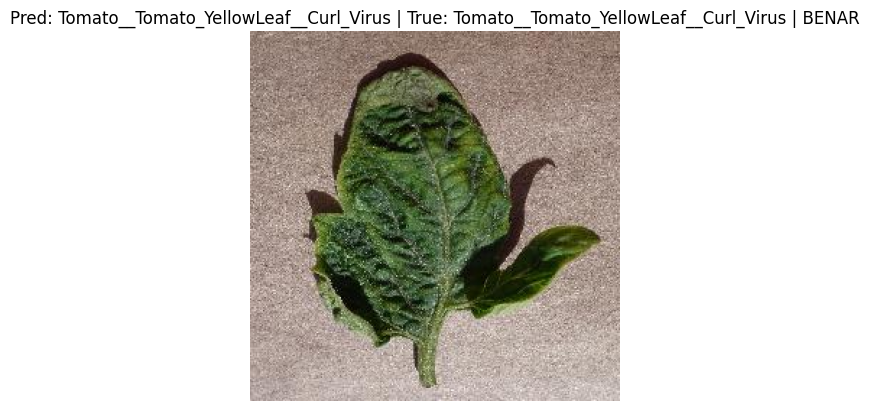

86. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/26b5797e-695b-4014-a0fb-a2e0e11a88f3___Matt.S_CG 7845.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


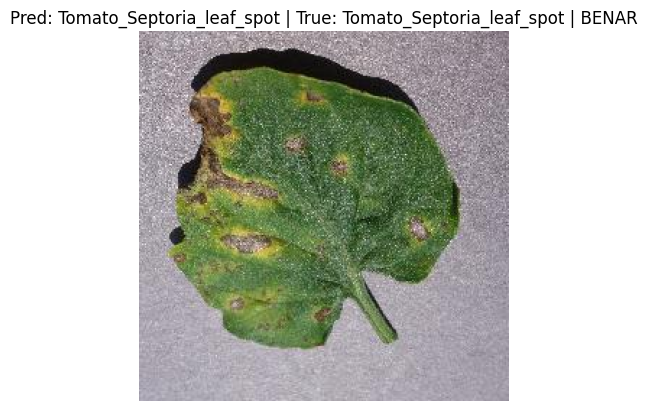

87. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/1e802d57-3ff5-4527-8c9a-b1b764d6ccc9___Com.G_SpM_FL 1522.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


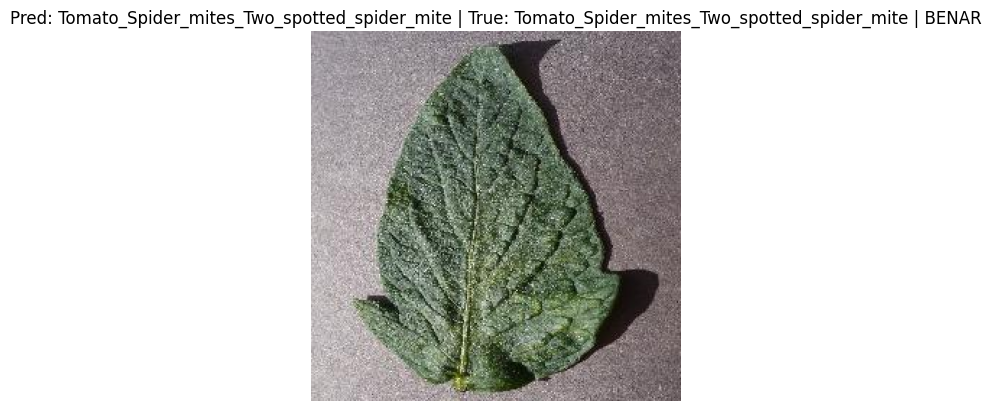

88. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/181ba21a-dd6f-4f26-b279-6734d3579449___Matt.S_CG 7593.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


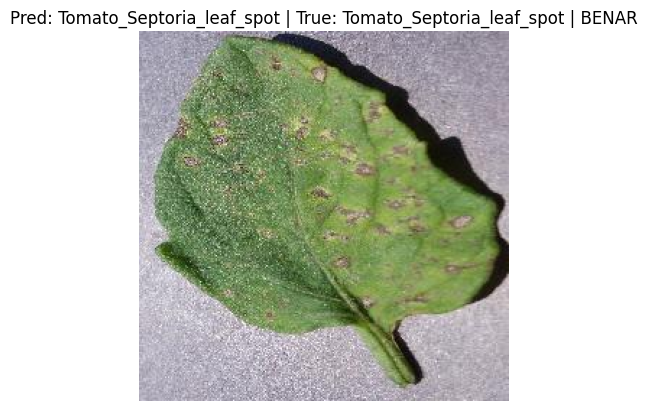

89. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/189f8e47-0892-4c82-b0b9-7a51b6c83a04___RS_Late.B 7193.JPG | Prediksi: Tomato_Early_blight | True: Tomato_Late_blight | SALAH


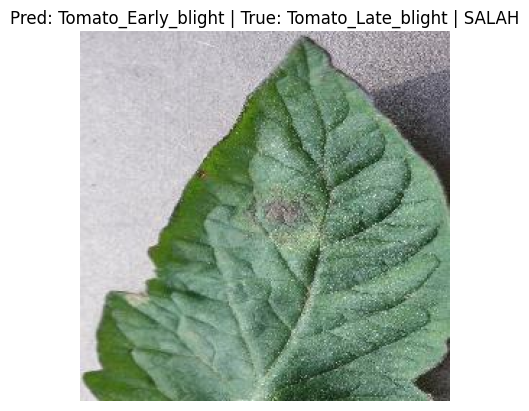

90. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/10a8ae32-5394-4cda-a99a-1c79501416d0___YLCV_NREC 2486.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


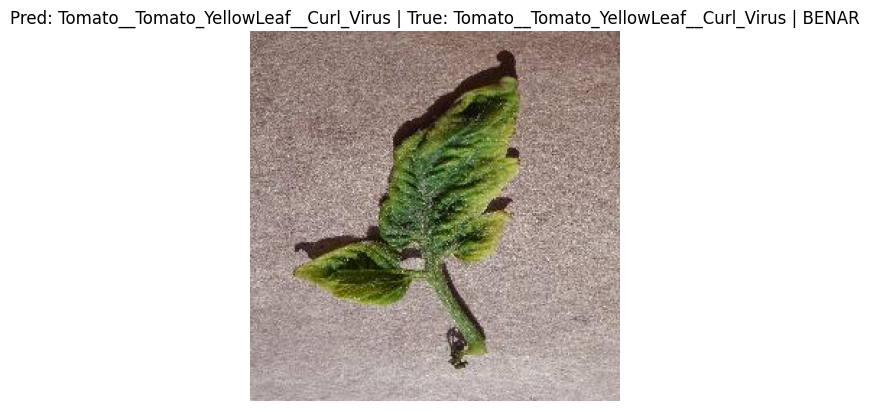

91. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/25b6cc2a-d883-4e3f-9caa-738e5ec35e30___JR_Sept.L.S 8465.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Septoria_leaf_spot | SALAH


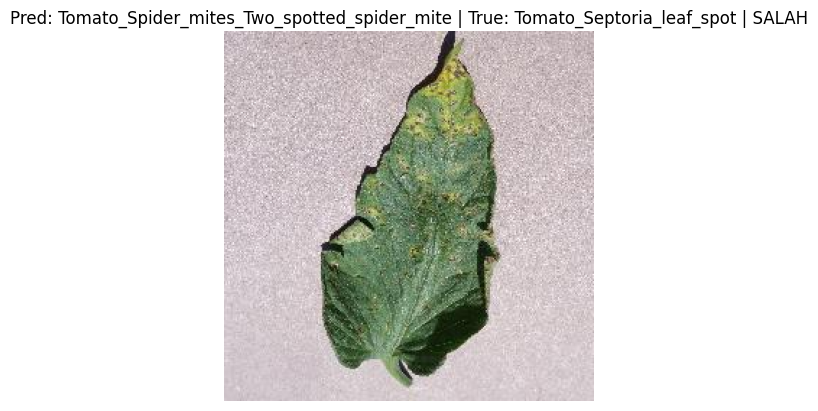

92. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/222f7028-4365-4d2e-ba07-aeb02d58f3f3___Com.G_SpM_FL 8636.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


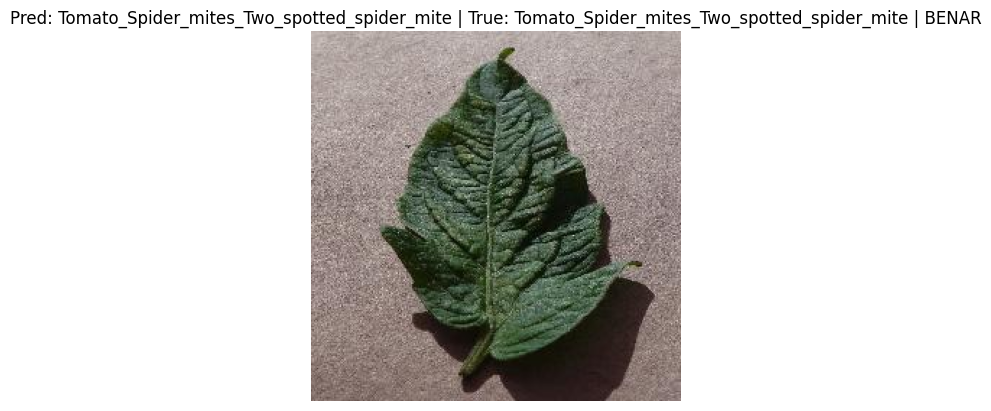

93. /kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/0d60ecc0-bb8e-4c07-9ad7-5e78aed53b1c___Matt.S_CG 6645.JPG | Prediksi: Tomato_Septoria_leaf_spot | True: Tomato_Septoria_leaf_spot | BENAR


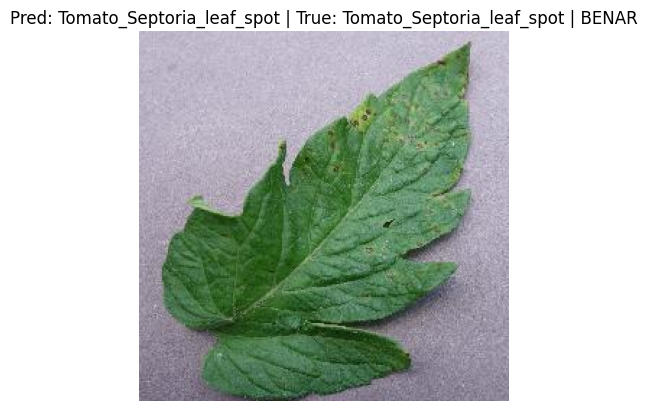

94. /kaggle/input/plantdisease/PlantVillage/Tomato_Leaf_Mold/2857df1b-3a91-46d2-ab63-926b329b4a28___Crnl_L.Mold 7102.JPG | Prediksi: Tomato_Leaf_Mold | True: Tomato_Leaf_Mold | BENAR


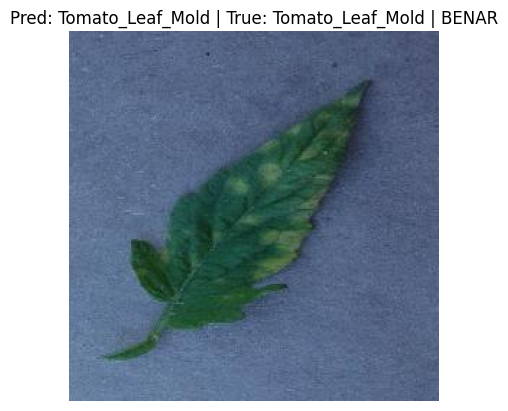

95. /kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/0922e026-b563-438d-b9ed-7476153023ce___YLCV_GCREC 2258.JPG | Prediksi: Tomato__Tomato_YellowLeaf__Curl_Virus | True: Tomato__Tomato_YellowLeaf__Curl_Virus | BENAR


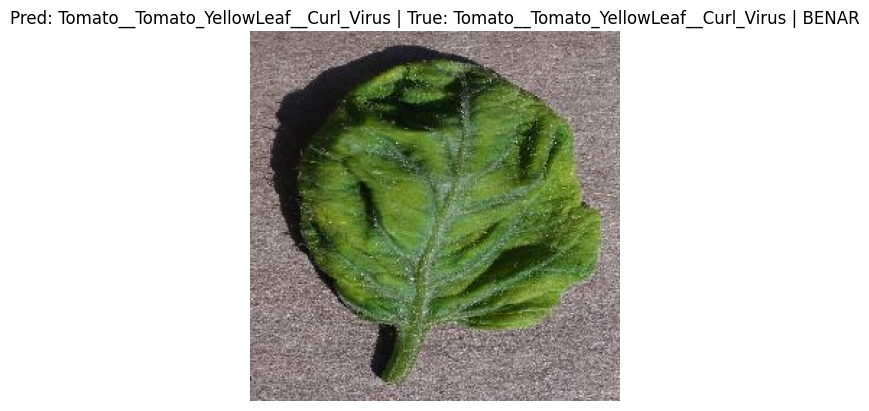

96. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/21833eb1-b84e-4471-816b-166e575ed0e7___GCREC_Bact.Sp 3244.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


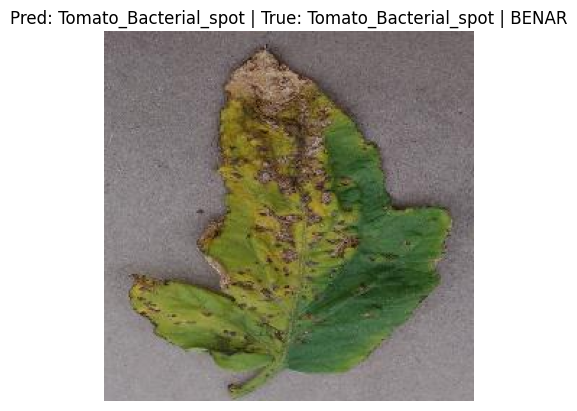

97. /kaggle/input/plantdisease/PlantVillage/Tomato_Late_blight/005e3b43-9050-47da-9498-f9ecdcc703b3___RS_Late.B 5104.JPG | Prediksi: Tomato_Late_blight | True: Tomato_Late_blight | BENAR


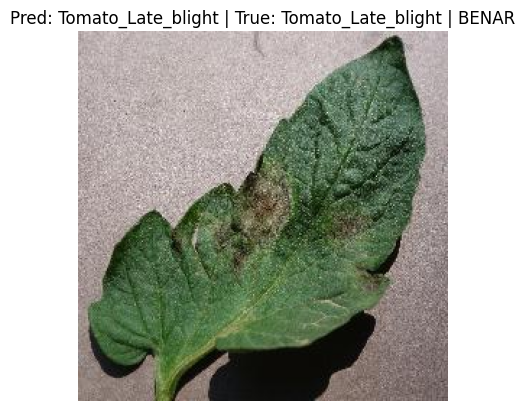

98. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/0d835caf-0069-4fa5-a022-c8cc7763189c___Com.G_SpM_FL 8917.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


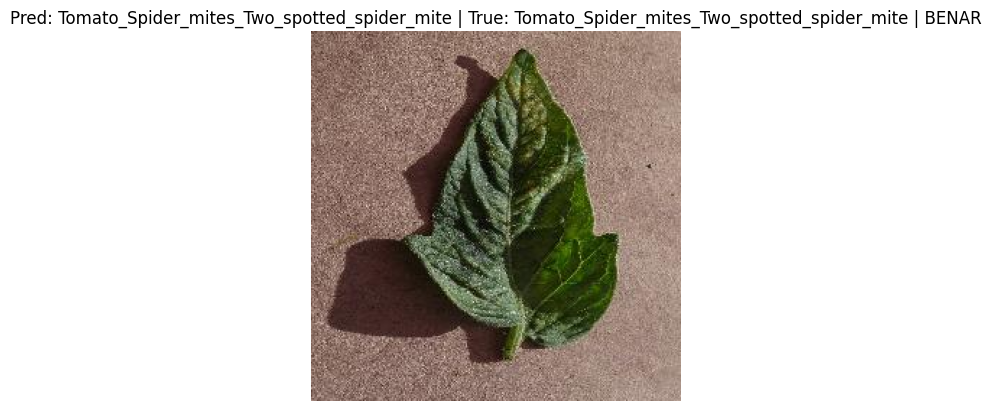

99. /kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/1c286bba-a5c0-466f-a52d-960d300d135f___GCREC_Bact.Sp 6077.JPG | Prediksi: Tomato_Bacterial_spot | True: Tomato_Bacterial_spot | BENAR


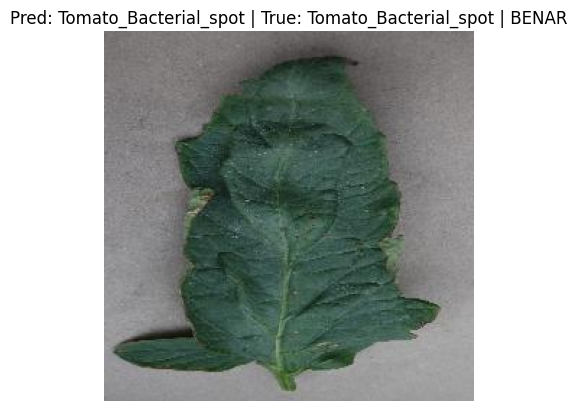

100. /kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/0f75930a-4f0c-49db-b5d8-6e4987b868eb___Com.G_SpM_FL 1729.JPG | Prediksi: Tomato_Spider_mites_Two_spotted_spider_mite | True: Tomato_Spider_mites_Two_spotted_spider_mite | BENAR


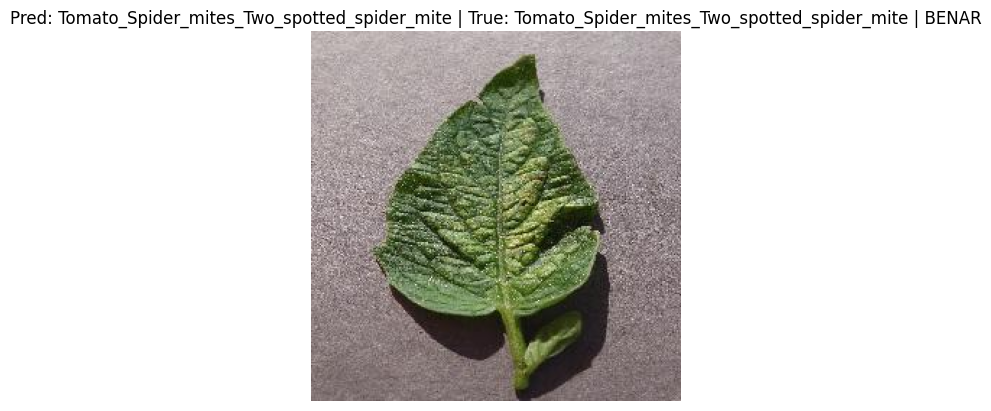


Total BENAR dari 100 gambar acak validasi: 94/100


In [10]:
import random

val_indices = list(range(len(y_true)))
random_100 = random.sample(val_indices, 100)
benar = 0

for i, idx in enumerate(random_100):
    img_path = val_flow.filepaths[idx]
    pred_label = class_labels[voted_preds[idx]]
    true_label = class_labels[y_true[idx]]
    is_correct = (pred_label == true_label)
    if is_correct:
        benar += 1
    print(f"{i+1}. {img_path} | Prediksi: {pred_label} | True: {true_label} | {'BENAR' if is_correct else 'SALAH'}")
    plt.imshow(plt.imread(img_path))
    plt.title(f"Pred: {pred_label} | True: {true_label} | {'BENAR' if is_correct else 'SALAH'}")
    plt.axis('off')
    plt.show()

print(f"\nTotal BENAR dari 100 gambar acak validasi: {benar}/100")
